## Business Problem

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, I will predict two things:

Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.

## Import Packages

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(style='whitegrid')
import warnings 
warnings.filterwarnings('ignore')
import pandas_profiling
from scipy.stats import zscore
from sklearn.linear_model import LogisticRegression,LinearRegression,Lasso,Ridge
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC,SVR
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier,DecisionTreeRegressor 
from sklearn.ensemble import RandomForestClassifier,RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier,GradientBoostingRegressor
import xgboost
from xgboost import XGBClassifier,XGBRegressor
from sklearn.preprocessing import StandardScaler,PowerTransformer,PolynomialFeatures
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error,accuracy_score,roc_auc_score,classification_report,confusion_matrix,roc_curve,auc,plot_roc_curve
plt.style.use('ggplot')
#Module related to VIF 
from statsmodels.stats.outliers_influence import variance_inflation_factor
#Moudles related to feature selection
from sklearn.feature_selection import RFE,SelectKBest,f_classif

## Create UDFs

In [2]:
# Create Data audit Report for continuous variables
def continuous_var_summary(x):
    return pd.Series([x.count(), x.isnull().sum(), x.sum(), x.mean(), x.median(),  
                      x.std(), x.var(), x.min(), x.quantile(0.01), x.quantile(0.05),
                          x.quantile(0.10),x.quantile(0.25),x.quantile(0.50),x.quantile(0.75), 
                              x.quantile(0.90),x.quantile(0.95), x.quantile(0.99),x.max()], 
                  index = ['N', 'NMISS', 'SUM', 'MEAN','MEDIAN', 'STD', 'VAR', 'MIN', 'P1', 
                               'P5' ,'P10' ,'P25' ,'P50' ,'P75' ,'P90' ,'P95' ,'P99' ,'MAX'])

## Import Data

In [3]:
df = pd.read_csv('E:/DataTrained/Intership_Flip Robo/final_projects/weatherAUS.csv')
pd. set_option('display.max_columns', 700)
pd.set_option('display.width', 100)
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


## Data Inspection

In [4]:
#profile = pandas_profiling.ProfileReport(df)
#profile.to_widgets()

In [5]:
# From profile report Pressure 9am & 3pm both have low Coefficient of variation (CV) 0.006 may drop them later.

In [6]:
# check the dataset shape
df.shape

(8425, 23)

In [7]:
# check dulpicated records
df.duplicated().sum()

1663

In [8]:
# drop duplicated records and reset the index
df.drop_duplicates(inplace=True)
df1=df.reset_index()

In [9]:
df1

,index,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6757,8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
6758,8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
6759,8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
6760,8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [10]:
df1.drop('index',axis=1,inplace=True)

In [11]:
# data info
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6762 entries, 0 to 6761
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           6762 non-null   object 
 1   Location       6762 non-null   object 
 2   MinTemp        6692 non-null   float64
 3   MaxTemp        6705 non-null   float64
 4   Rainfall       6624 non-null   float64
 5   Evaporation    3841 non-null   float64
 6   Sunshine       3526 non-null   float64
 7   WindGustDir    5820 non-null   object 
 8   WindGustSpeed  5820 non-null   float64
 9   WindDir9am     5968 non-null   object 
 10  WindDir3pm     6468 non-null   object 
 11  WindSpeed9am   6699 non-null   float64
 12  WindSpeed3pm   6662 non-null   float64
 13  Humidity9am    6708 non-null   float64
 14  Humidity3pm    6666 non-null   float64
 15  Pressure9am    5454 non-null   float64
 16  Pressure3pm    5451 non-null   float64
 17  Cloud9am       4896 non-null   float64
 18  Cloud3pm

##### The Dataset  has 6762 rows and 23 columns consists of 16 continous variables and 7 categorical.

In [12]:
# Treat date as datetime type and extract day,month and year from it.
import datetime as dt

df1["Date"]=pd.to_datetime(df1["Date"])

df1["Year"]=df1["Date"].dt.year
df1["Month"]=df1["Date"].dt.month
df1["Day"]=df1["Date"].dt.day

In [13]:
# drop col. date as high cardinality
df1.drop('Date',axis=1,inplace=True)

In [14]:
# Check null values in  data
df1.isnull().sum()

Location            0
MinTemp            70
MaxTemp            57
Rainfall          138
Evaporation      2921
Sunshine         3236
WindGustDir       942
WindGustSpeed     942
WindDir9am        794
WindDir3pm        294
WindSpeed9am       63
WindSpeed3pm      100
Humidity9am        54
Humidity3pm        96
Pressure9am      1308
Pressure3pm      1311
Cloud9am         1866
Cloud3pm         1902
Temp9am            51
Temp3pm            92
RainToday         138
RainTomorrow      138
Year                0
Month               0
Day                 0
dtype: int64

##### We can see few missing values are present.

In [15]:
# for classification problem i 'll drop the records in the missing target feature
df_class=df1[~df1.RainTomorrow.isnull()]
df_class

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6756,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,No,No,2017,6,20
6757,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No,2017,6,21
6758,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No,2017,6,22
6759,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No,2017,6,23


In [16]:
# for regression problem i 'll drop the records in the missing target feature
df_reg=df1[~df1.Rainfall.isnull()]
df_reg

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6757,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No,2017,6,21
6758,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No,2017,6,22
6759,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No,2017,6,23
6760,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No,2017,6,24


In [17]:
df_class.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6624 entries, 0 to 6760
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Location       6624 non-null   object 
 1   MinTemp        6567 non-null   float64
 2   MaxTemp        6589 non-null   float64
 3   Rainfall       6558 non-null   float64
 4   Evaporation    3764 non-null   float64
 5   Sunshine       3461 non-null   float64
 6   WindGustDir    5716 non-null   object 
 7   WindGustSpeed  5716 non-null   float64
 8   WindDir9am     5846 non-null   object 
 9   WindDir3pm     6348 non-null   object 
 10  WindSpeed9am   6573 non-null   float64
 11  WindSpeed3pm   6541 non-null   float64
 12  Humidity9am    6583 non-null   float64
 13  Humidity3pm    6544 non-null   float64
 14  Pressure9am    5333 non-null   float64
 15  Pressure3pm    5332 non-null   float64
 16  Cloud9am       4835 non-null   float64
 17  Cloud3pm       4795 non-null   float64
 18  Temp9am 

In [18]:
# Value counts for every feature to check the missing again or unique values
for i in df_class.columns:
    print(df_class[i].value_counts())
    print('**********************************')

PerthAirport    1204
Albury           898
Newcastle        808
Melbourne        751
CoffsHarbour     610
Williamtown      577
Brisbane         574
Penrith          479
Darwin           250
Wollongong       234
Adelaide         201
Uluru             38
Name: Location, dtype: int64
**********************************
 13.2    57
 12.0    56
 12.7    52
 10.8    52
 17.8    51
         ..
 28.0     1
-0.8      1
-1.5      1
-1.7      1
 26.0     1
Name: MinTemp, Length: 285, dtype: int64
**********************************
19.0    66
19.8    62
22.3    54
20.8    54
23.8    53
        ..
10.3     1
10.0     1
10.4     1
11.7     1
43.5     1
Name: MaxTemp, Length: 331, dtype: int64
**********************************
0.0      4292
0.2       320
0.4       144
0.6        85
1.2        68
         ... 
141.8       1
49.6        1
30.0        1
37.6        1
40.0        1
Name: Rainfall, Length: 250, dtype: int64
**********************************
4.0      137
3.0      123
2.2      116
2.6      

In [19]:
# Check null values in  data
df_class.isnull().sum()

Location            0
MinTemp            57
MaxTemp            35
Rainfall           66
Evaporation      2860
Sunshine         3163
WindGustDir       908
WindGustSpeed     908
WindDir9am        778
WindDir3pm        276
WindSpeed9am       51
WindSpeed3pm       83
Humidity9am        41
Humidity3pm        80
Pressure9am      1291
Pressure3pm      1292
Cloud9am         1789
Cloud3pm         1829
Temp9am            38
Temp3pm            76
RainToday          66
RainTomorrow        0
Year                0
Month               0
Day                 0
dtype: int64

In [20]:
# Check null values in  data
df_reg.isnull().sum()

Location            0
MinTemp            49
MaxTemp            44
Rainfall            0
Evaporation      2848
Sunshine         3164
WindGustDir       923
WindGustSpeed     923
WindDir9am        770
WindDir3pm        279
WindSpeed9am       42
WindSpeed3pm       85
Humidity9am        37
Humidity3pm        82
Pressure9am      1291
Pressure3pm      1294
Cloud9am         1758
Cloud3pm         1802
Temp9am            34
Temp3pm            78
RainToday           0
RainTomorrow       66
Year                0
Month               0
Day                 0
dtype: int64

In [21]:
#lets check skewness of the data to finalize imputation with mean or median

df_class.skew()


MinTemp          -0.071051
MaxTemp           0.334023
Rainfall         13.584687
Evaporation      10.271243
Sunshine         -0.653297
WindGustSpeed     0.715209
WindSpeed9am      0.936821
WindSpeed3pm      0.553864
Humidity9am      -0.252527
Humidity3pm       0.150249
Pressure9am       0.016183
Pressure3pm       0.036438
Cloud9am         -0.168144
Cloud3pm         -0.129618
Temp9am          -0.043727
Temp3pm           0.350964
Year              0.357394
Month             0.025363
Day               0.003374
dtype: float64

In [22]:
df_reg.skew()

MinTemp          -0.075240
MaxTemp           0.327964
Rainfall         13.510350
Evaporation      10.258275
Sunshine         -0.648264
WindGustSpeed     0.728613
WindSpeed9am      0.961507
WindSpeed3pm      0.552671
Humidity9am      -0.251285
Humidity3pm       0.152855
Pressure9am       0.019086
Pressure3pm       0.042878
Cloud9am         -0.177431
Cloud3pm         -0.136219
Temp9am          -0.045943
Temp3pm           0.345044
Year              0.357834
Month             0.025191
Day               0.003288
dtype: float64

##### We have skewness present in Rainfall, Evaporation,WindGustSpeed and WindSpeed9am. we can replace it with median and rest all with mean

-------------------------------------------------------------------------------------------------------------------------------

In [23]:
# split train data to continous and categorical varaiables.
num=df_class.select_dtypes(include=['float64','int64'])
cat=df_class.select_dtypes(include=['object'])

In [24]:
# replacing nan values in columns having skewness
df_class["Rainfall"] = df_class["Rainfall"].fillna(df_class["Rainfall"].median())
df_class["Evaporation"] = df_class["Evaporation"].fillna(df_class["Evaporation"].median())
df_class["WindGustSpeed"] = df_class["WindGustSpeed"].fillna(df_class["WindGustSpeed"].median())
df_class["WindSpeed9am"] = df_class["WindSpeed9am"].fillna(df_class["WindSpeed9am"].median())

In [25]:
# replacing nan values in columns having skewness

df_reg["Evaporation"] = df_reg["Evaporation"].fillna(df_reg["Evaporation"].median())
df_reg["WindGustSpeed"] = df_reg["WindGustSpeed"].fillna(df_reg["WindGustSpeed"].median())
df_reg["WindSpeed9am"] = df_reg["WindSpeed9am"].fillna(df_reg["WindSpeed9am"].median())

In [26]:
for i in num.columns.difference(['Evaporation','WindGustSpeed','WindSpeed9am']):
    df_class[i]=df_class[i].fillna(df_class[i].mean())

In [27]:
for i in num.columns.difference(['Evaporation','WindGustSpeed','WindSpeed9am']):
    df_reg[i]=df_reg[i].fillna(df_reg[i].mean())

In [28]:
#  replacing nan values for categorical features.
for i in cat.columns:
    df_class[i]=df_class[i].fillna(df_class[i].mode()[0])

In [29]:
#  replacing nan values for categorical features.
for i in cat.columns:
    df_reg[i]=df_reg[i].fillna(df_reg[i].mode()[0])

In [30]:
# check the null vakues
df_class.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
Year             0
Month            0
Day              0
dtype: int64

In [31]:
# check the null vakues
df_reg.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
Year             0
Month            0
Day              0
dtype: int64

In [32]:
# Check imbalance of the target data
df_class.RainTomorrow.value_counts(normalize=True)

No     0.762681
Yes    0.237319
Name: RainTomorrow, dtype: float64

##### Data is some how imbalance and will deal with later.

-------------------------------------------------------------------------------------------------------------------------------

In [33]:
num_class=df_class.select_dtypes(include=['float64','int64'])
cat_class=df_class.select_dtypes(include=['object'])

In [34]:
num_reg=df_reg.select_dtypes(include=['float64','int64'])
cat_reg=df_reg.select_dtypes(include=['object'])

In [35]:
# Descriptive analysis for continous data
num_class.apply(continuous_var_summary)

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year,Month,Day
N,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6.624000e+03,6.624000e+03,6624.000000,6624.000000,6624.000000,6624.000000,6.624000e+03,6624.000000,6624.000000
NMISS,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000
SUM,86618.357241,159553.953802,18173.100000,33160.700000,52545.104883,255749.000000,84252.000000,116099.752331,446788.447820,333915.799511,6.741070e+06,6.724443e+06,28540.055429,28514.282377,118463.390708,150378.760171,1.332774e+07,42619.000000,104321.000000
MEAN,13.076443,24.087251,2.743524,5.006144,7.932534,38.609450,12.719203,17.527137,67.449947,50.409994,1.017674e+03,1.015163e+03,4.308583,4.304692,17.883966,22.702108,2.012037e+03,6.434028,15.748943
MEDIAN,13.076443,23.500000,0.000000,4.600000,7.932534,37.000000,11.000000,17.000000,68.000000,50.000000,1.017674e+03,1.015163e+03,4.308583,4.304692,17.900000,22.200000,2.012000e+03,6.000000,16.000000
STD,5.557813,6.128234,10.550026,3.378275,2.725977,13.370111,9.778181,9.566005,17.207587,18.512733,6.025867e+00,5.962274e+00,2.485094,2.330785,5.729483,5.967396,2.296982e+00,3.359329,8.794511
VAR,30.889281,37.555248,111.303041,11.412743,7.430949,178.759874,95.612822,91.508445,296.101051,342.721272,3.631107e+01,3.554872e+01,6.175690,5.432560,32.826971,35.609810,5.276127e+00,11.285093,77.343423
MIN,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,9.898000e+02,9.829000e+02,0.000000,0.000000,1.900000,7.300000,2.008000e+03,1.000000,1.000000
P1,0.900000,12.200000,0.000000,0.600000,0.000000,13.000000,0.000000,0.000000,26.000000,11.000000,1.002823e+03,1.000923e+03,0.000000,0.000000,5.100000,11.200000,2.009000e+03,1.000000,1.000000
P5,3.900000,14.900000,0.000000,1.600000,1.500000,19.000000,0.000000,4.000000,38.000000,20.000000,1.007500e+03,1.005200e+03,0.000000,0.150000,8.400000,13.700000,2.009000e+03,1.000000,2.000000


In [36]:
# Descriptive analysis for categorical data
cat_class.describe(include='O')

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count,6624,6624,6624,6624,6624,6624
unique,12,16,16,16,2,2
top,PerthAirport,E,N,SE,No,No
freq,1204,1425,1368,944,5071,5052


In [37]:
# Descriptive analysis for continous data
num_reg.apply(continuous_var_summary)

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year,Month,Day
N,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6624.000000,6.624000e+03,6.624000e+03,6624.000000,6624.000000,6624.000000,6624.000000,6.624000e+03,6624.000000,6624.000000
NMISS,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000
SUM,86638.192426,159604.273313,18415.700000,33191.500000,52490.222428,255745.000000,84225.000000,115812.115614,446930.441172,334173.813513,6.741117e+06,6.724415e+06,28642.742293,28588.150975,118509.591988,150418.330339,1.332774e+07,42607.000000,104392.000000
MEAN,13.079437,24.094848,2.780148,5.010794,7.924249,38.608847,12.715127,17.483713,67.471383,50.448945,1.017681e+03,1.015159e+03,4.324085,4.315844,17.890941,22.708081,2.012039e+03,6.432216,15.759662
MEDIAN,13.100000,23.500000,0.000000,4.600000,7.924249,37.000000,11.000000,17.000000,68.000000,50.000000,1.017681e+03,1.015159e+03,4.324085,4.315844,17.900000,22.200000,2.012000e+03,6.000000,16.000000
STD,5.560955,6.127989,10.591418,3.381927,2.724450,13.394307,9.817783,9.545389,17.219806,18.529500,6.012086e+00,5.947806e+00,2.491535,2.337840,5.728135,5.970288,2.297255e+00,3.358574,8.795574
VAR,30.924222,37.552245,112.178137,11.437427,7.422630,179.407447,96.388864,91.114452,296.521721,343.342360,3.614517e+01,3.537640e+01,6.207748,5.465494,32.811528,35.644334,5.277383e+00,11.280019,77.362129
MIN,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,9.898000e+02,9.829000e+02,0.000000,0.000000,1.900000,7.300000,2.008000e+03,1.000000,1.000000
P1,0.900000,12.200000,0.000000,0.600000,0.000000,13.000000,0.000000,0.000000,26.000000,11.000000,1.002900e+03,1.001100e+03,0.000000,0.000000,5.123000,11.100000,2.009000e+03,1.000000,1.000000
P5,3.900000,14.900000,0.000000,1.600000,1.500000,19.000000,0.000000,4.000000,38.000000,20.000000,1.007600e+03,1.005200e+03,0.000000,0.150000,8.400000,13.700000,2.009000e+03,1.000000,2.000000


In [38]:
# Descriptive analysis for categorical data
cat_reg.describe(include='O')

,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count,6624,6624,6624,6624,6624,6624
unique,12,16,16,16,2,2
top,PerthAirport,E,N,SE,No,No
freq,1204,1436,1360,949,5052,5089


## EDA

#### Univariate analysis

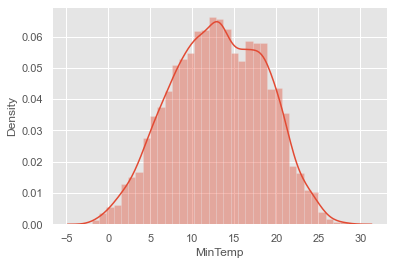

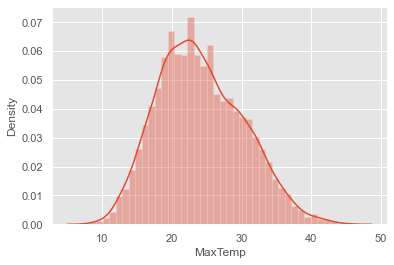

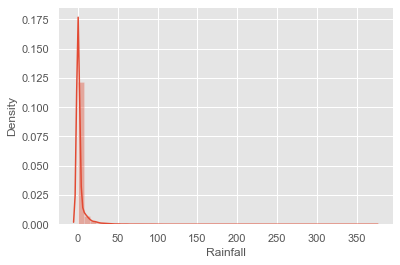

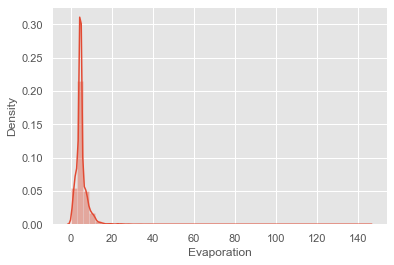

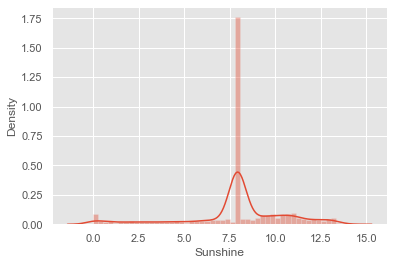

...

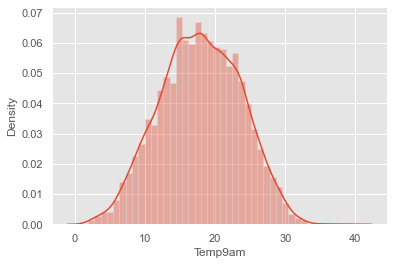

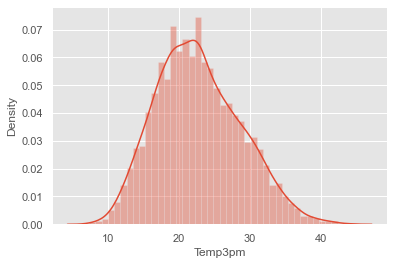

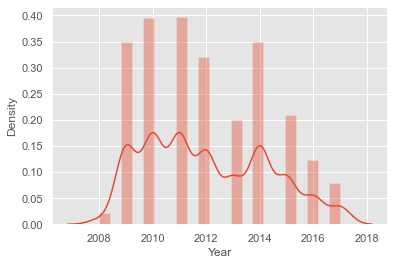

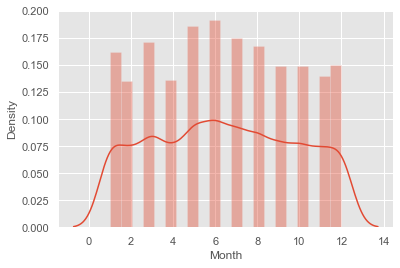

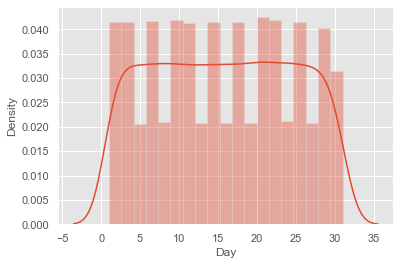

In [39]:
# Check Normality of continous data
for i in num_class.columns:
    sns.distplot(num_class[i])
    plt.show()

 Right Skewness is present in some features.

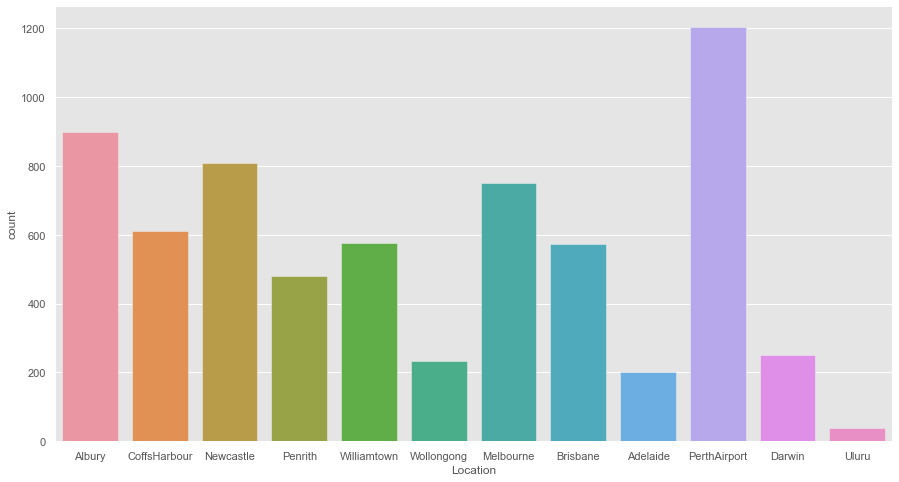

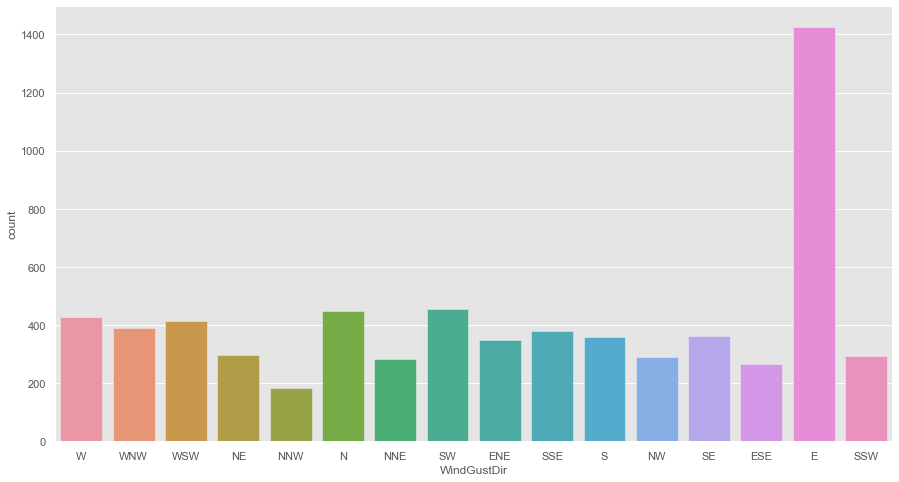

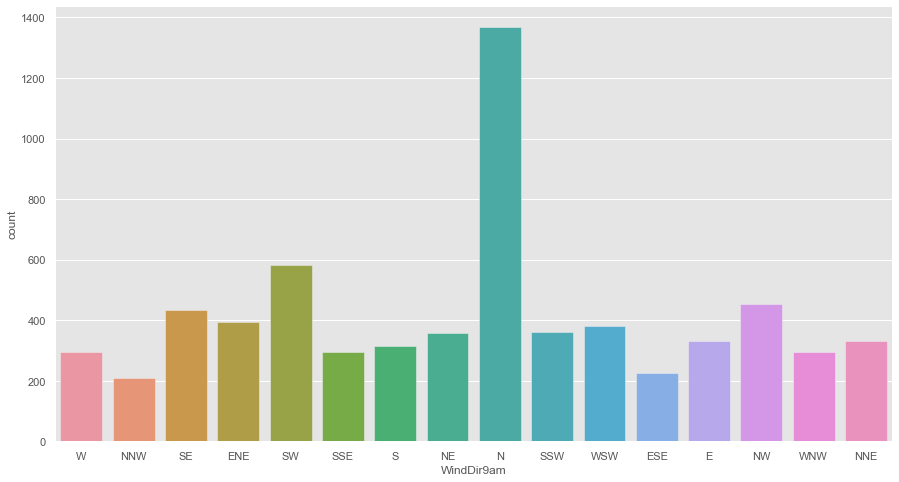

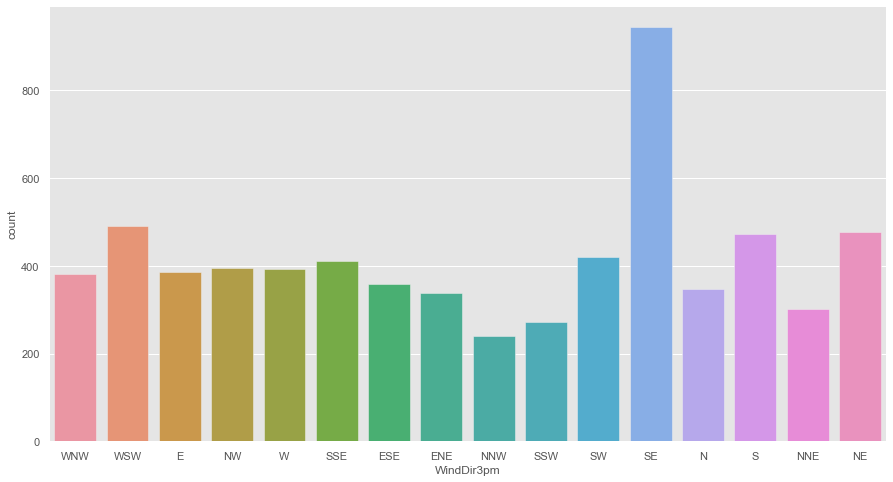

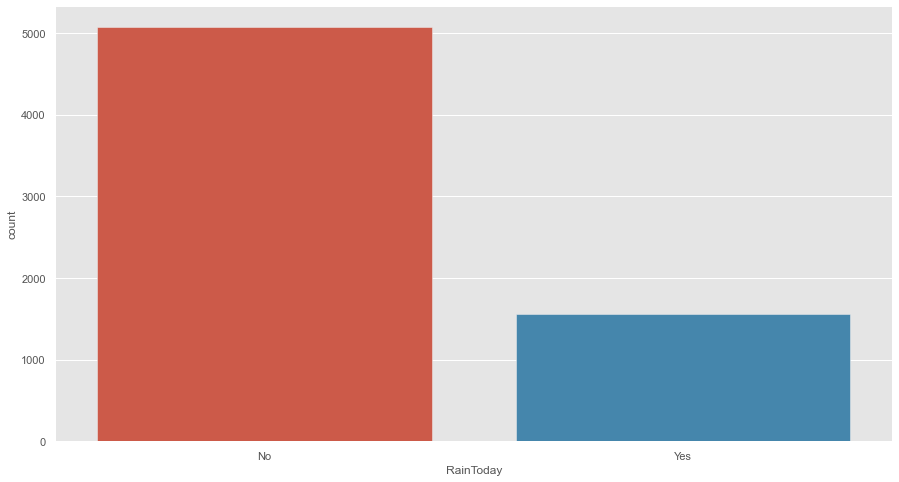

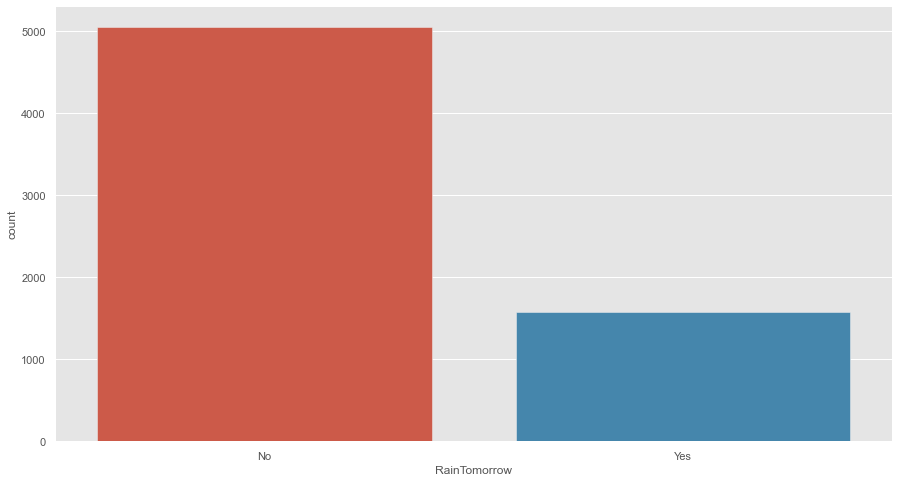

In [40]:
# Check count of categorical data
for i in cat_class.columns:
    plt.figure(figsize=(15,8))
    sns.countplot(cat_class[i])
    plt.show()

#### Bivariate analysis

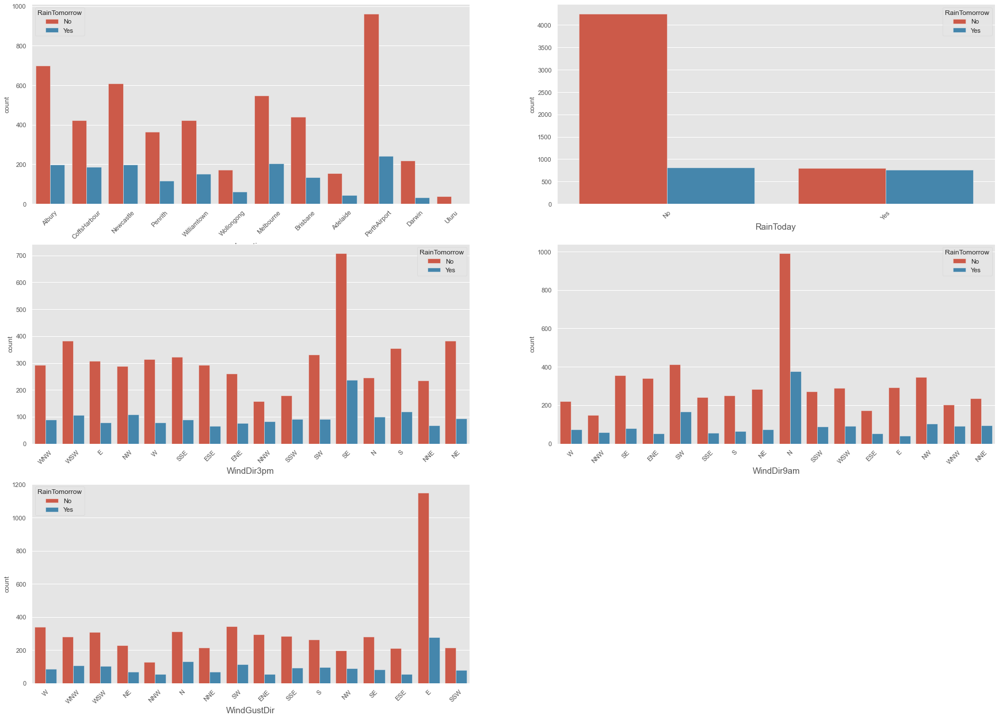

In [41]:
# Categorical variables Vs Target feature (Income)
plt.figure(figsize=(30,60), facecolor='white')
plotnumber = 1

for i in cat_class.columns.difference(['RainTomorrow']):
    if plotnumber<=20 :
        ax = plt.subplot(8,2,plotnumber)
        sns.countplot(x=df_class[i],hue=df_class.RainTomorrow)
        plt.xlabel(i,fontsize=15)
        plt.xticks(rotation=45)
       
    plotnumber+=1
plt.show()

In [42]:
num.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm',
       'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Year', 'Month', 'Day'],
      dtype='object')

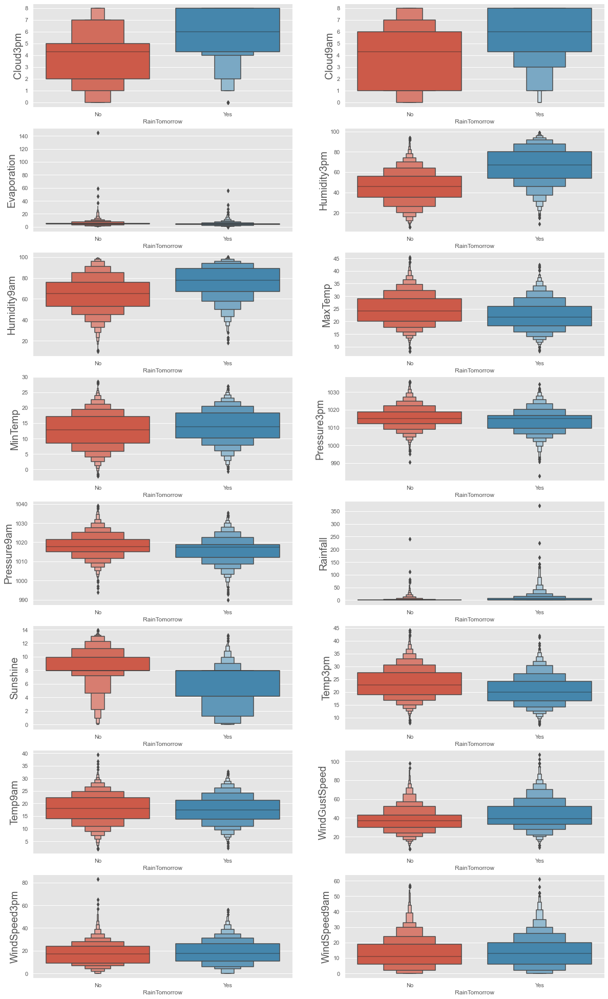

In [43]:
#relationship between Numerical columns and Target variable (RainTomorrow)

plt.figure(figsize=(20,35), facecolor='white')
plotnumber = 1

for i in num_class.columns.difference(['Year', 'Month', 'Day']):
    if plotnumber<=16 :
        ax = plt.subplot(8,2,plotnumber)
        sns.boxenplot(x=df_class.RainTomorrow,y=df_class[i])
        plt.ylabel(i,fontsize=20)
       
    plotnumber+=1
plt.show()

<AxesSubplot:xlabel='Year', ylabel='Rainfall'>

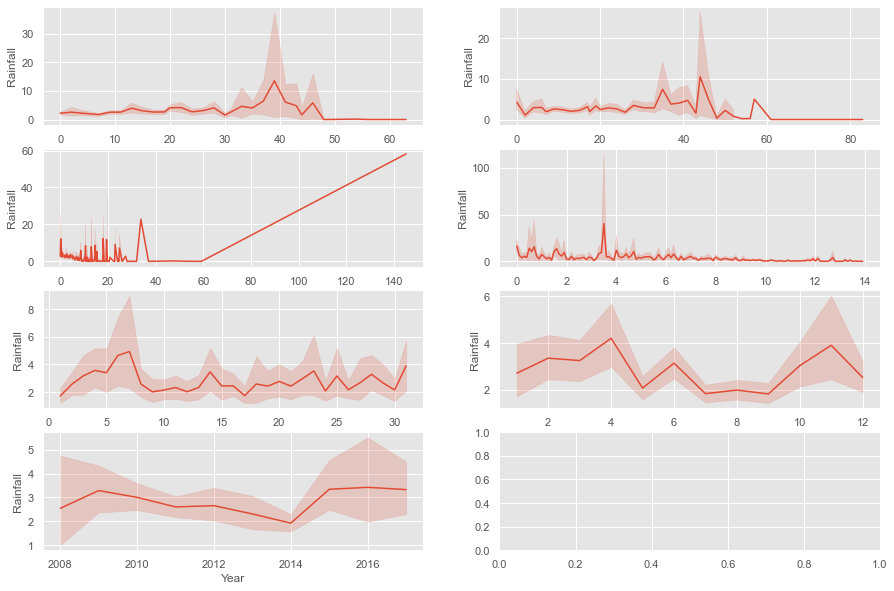

In [44]:
#lets check the plot between variables and our second target Rainfall

fig,axes=plt.subplots(4,2,figsize=(15,10))

#checking the relation between WindSpeed9am and Rainfall
sns.lineplot(x='WindSpeed9am',y='Rainfall',ax=axes[0,0],data=df_reg)

#checking the relation between WindSpeed3pm and Rainfall
sns.lineplot(x='WindSpeed3pm',y='Rainfall',ax=axes[0,1],data=df_reg)
#checking the relation between Evaporation and Rainfall
sns.lineplot(x='Evaporation',y='Rainfall',ax=axes[1,0],data=df_reg)

#checking the relation between Sunshine and Rainfall
sns.lineplot(x='Sunshine',y='Rainfall',ax=axes[1,1],data=df_reg)

#checking the relation between Day and Rainfall
sns.lineplot(x='Day',y='Rainfall',ax=axes[2,0],data=df_reg)

#checking the relation between Month and Rainfall
sns.lineplot(x='Month',y='Rainfall',ax=axes[2,1],data=df_reg)

#checking the relation between Year and Rainfall
sns.lineplot(x='Year',y='Rainfall',ax=axes[3,0],data=df_reg)

In the morning, at Windspeed between 30 to 40 km/h the rainfall is more.
In the evening, at Windspeed and rainfall pattern varies.
We can see that Evaporation and rainfall is correlated highly.
Lesser sunshine more rainfall.
pril, June and November has the highest Rainfall.

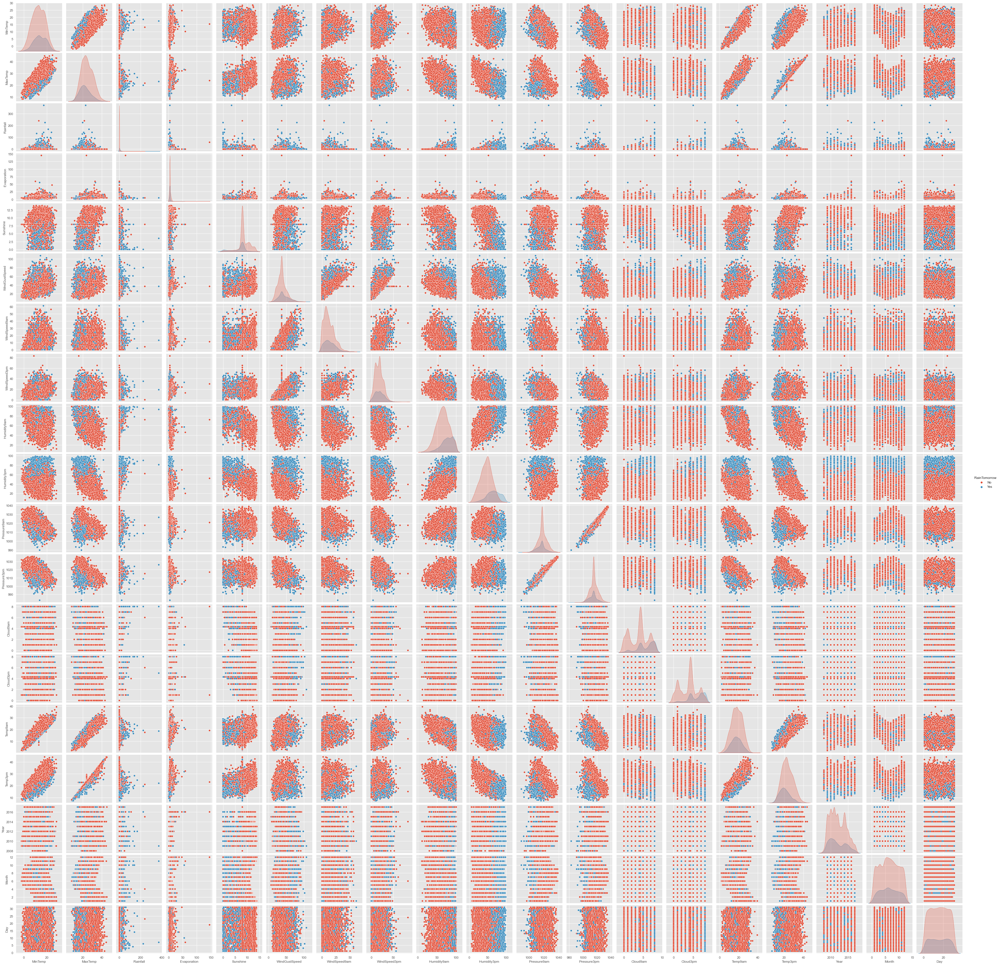

In [45]:
sns.pairplot(df_class,hue="RainTomorrow")
plt.show()

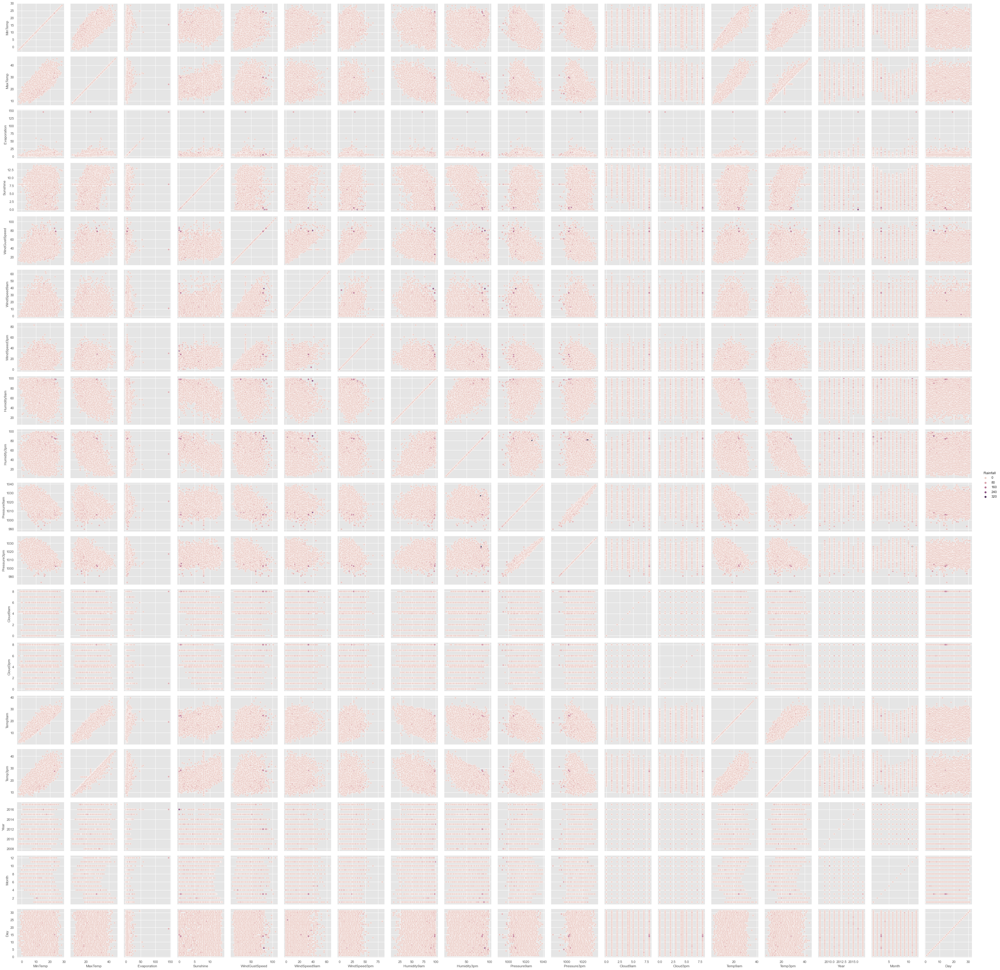

In [46]:
g = sns.PairGrid(df_reg , hue = 'Rainfall')
g = g.map(sns.scatterplot)
g.add_legend()

-------------------------------------------------------------------------------------------------------------------------------

### Outliers treatment 

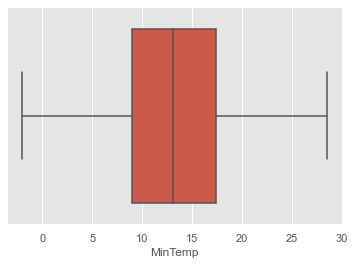

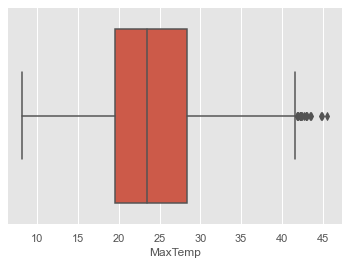

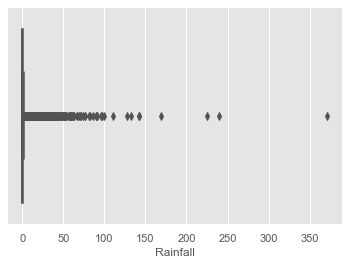

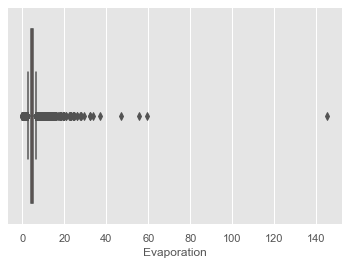

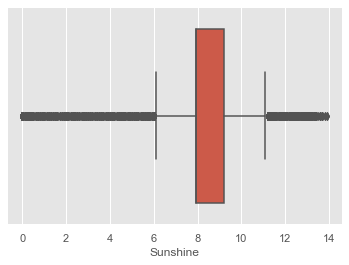

...

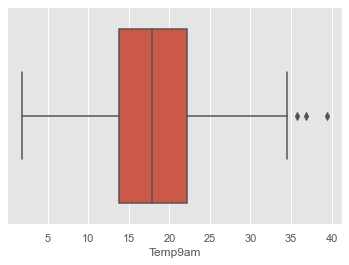

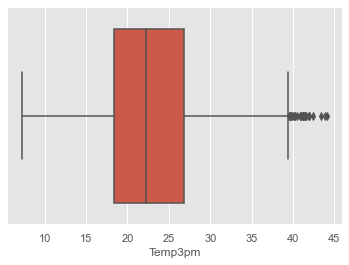

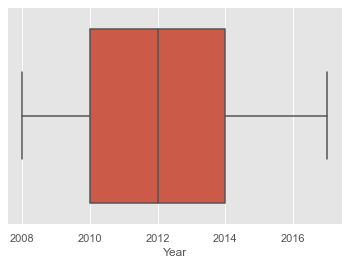

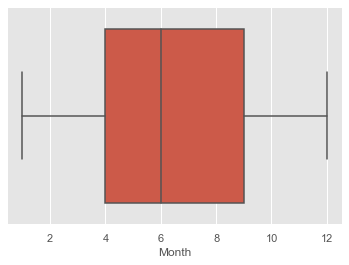

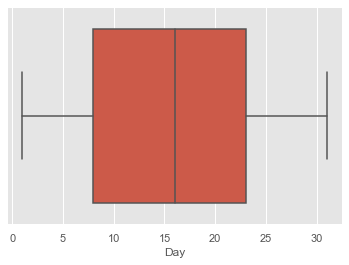

In [47]:
# Check outliers using boxplot
for col in num_class.columns:
    sns.boxplot(num_class[col])
    plt.show()

In [49]:
### use Z-score method
outliers=df_class[num_class.columns.difference(['MinTemp','Cloud9am','Cloud3pm','Year','Month','Day'])]
z=np.abs(zscore(outliers))
df_new_class=df_class[(z<3).all(axis=1)]
df_new_class

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.9,0.6,4.6,7.932534,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.304692,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.1,0.0,4.6,7.932534,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.308583,4.304692,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.7,0.0,4.6,7.932534,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.308583,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.0,0.0,4.6,7.932534,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.308583,4.304692,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.3,1.0,4.6,7.932534,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6756,Uluru,3.5,21.8,0.0,4.6,7.932534,E,31.0,ESE,E,15.0,13.0,59.0,27.0,1024.7,1021.2,4.308583,4.304692,9.4,20.9,No,No,2017,6,20
6757,Uluru,2.8,23.4,0.0,4.6,7.932534,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,4.308583,4.304692,10.1,22.4,No,No,2017,6,21
6758,Uluru,3.6,25.3,0.0,4.6,7.932534,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,4.308583,4.304692,10.9,24.5,No,No,2017,6,22
6759,Uluru,5.4,26.9,0.0,4.6,7.932534,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,4.308583,4.304692,12.5,26.1,No,No,2017,6,23


In [50]:
# data loss percentage for class problem

loss_percentage_class= ((df_class.shape[0]- df_new_class.shape[0])/num.shape[0])*100
loss_percentage_class

5.208333333333334

##### It's acceptable.

In [51]:
# Check Skewness
df_new_class.skew()

MinTemp         -0.067607
MaxTemp          0.270232
Rainfall         3.525420
Evaporation      1.121850
Sunshine        -0.913127
WindGustSpeed    0.553349
WindSpeed9am     0.680388
WindSpeed3pm     0.347959
Humidity9am     -0.233011
Humidity3pm      0.159554
Pressure9am      0.060329
Pressure3pm      0.090941
Cloud9am        -0.185151
Cloud3pm        -0.136931
Temp9am         -0.070203
Temp3pm          0.291318
Year             0.355777
Month            0.035620
Day              0.001904
dtype: float64

In [52]:
# I'll consider -0.5/0.5 is ok among features skewness and treat the others features.

skew_cols=['Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am']

In [53]:
# withing Power transformer to treat skewness
scaler = PowerTransformer()
df_new_class[skew_cols] = scaler.fit_transform(df_new_class[skew_cols].values)

In [54]:
cat_class.columns

Index(['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow'], dtype='object')

In [55]:
# Encoding

# use getdummies for nominal features like; gelocation source and other fuel, while use ordinal encoder for target feature

#Encoding the target feature:

encode_cols=['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']


from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

for i in encode_cols:
    df_new_class[i]=enc.fit_transform(df_new_class[i].values.reshape(-1,1))
    
df_new_class=pd.get_dummies(df_new_class,columns=['RainToday','RainTomorrow'],drop_first=True)

In [56]:
df_new_class

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year,Month,Day,RainToday_Yes,RainTomorrow_Yes
0,1.0,13.4,22.9,0.787183,0.016708,-0.120935,13.0,0.574142,13.0,14.0,0.909985,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.304692,16.9,21.8,2008,12,1,0,0
1,1.0,7.4,25.1,-0.650603,0.016708,-0.120935,14.0,0.574142,6.0,15.0,-0.848113,22.0,44.0,25.0,1010.6,1007.8,4.308583,4.304692,17.2,24.3,2008,12,2,0,0
2,1.0,12.9,25.7,-0.650603,0.016708,-0.120935,15.0,0.722050,13.0,15.0,0.827976,26.0,38.0,30.0,1007.6,1008.7,4.308583,2.000000,21.0,23.2,2008,12,3,0,0
3,1.0,9.2,28.0,-0.650603,0.016708,-0.120935,4.0,-1.160251,9.0,0.0,0.076478,9.0,45.0,16.0,1017.6,1012.8,4.308583,4.304692,18.1,26.5,2008,12,4,0,0
4,1.0,17.5,32.3,1.150236,0.016708,-0.120935,13.0,0.345458,1.0,7.0,-0.400649,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,2008,12,5,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6756,9.0,3.5,21.8,-0.650603,0.016708,-0.120935,0.0,-0.488442,2.0,0.0,0.476692,13.0,59.0,27.0,1024.7,1021.2,4.308583,4.304692,9.4,20.9,2017,6,20,0,0
6757,9.0,2.8,23.4,-0.650603,0.016708,-0.120935,0.0,-0.488442,9.0,1.0,0.283970,11.0,51.0,24.0,1024.6,1020.3,4.308583,4.304692,10.1,22.4,2017,6,21,0,0
6758,9.0,3.6,25.3,-0.650603,0.016708,-0.120935,6.0,-1.370475,9.0,3.0,0.283970,9.0,56.0,21.0,1023.5,1019.1,4.308583,4.304692,10.9,24.5,2017,6,22,0,0
6759,9.0,5.4,26.9,-0.650603,0.016708,-0.120935,3.0,0.026356,9.0,14.0,-0.149713,9.0,53.0,24.0,1021.0,1016.8,4.308583,4.304692,12.5,26.1,2017,6,23,0,0


-------------------------------------------------------------------------------------------------------------------------------

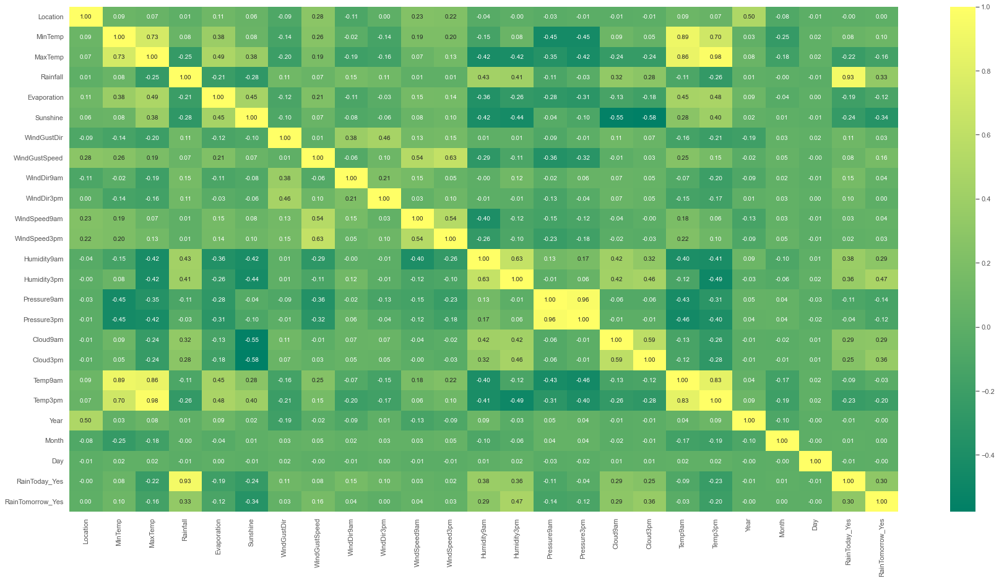

In [57]:
# heatmap correlation
plt.figure(figsize = (30,15))
sns.heatmap(df_new_class.corr(), annot=True,cmap='summer',fmt='.2f')
plt.show()

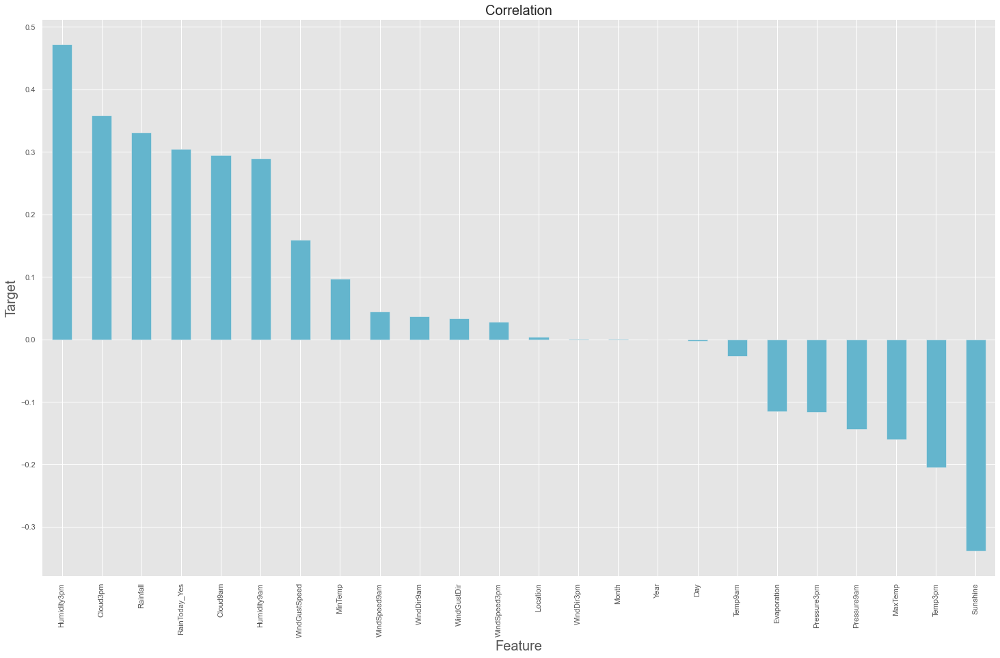

In [58]:
#Visualization of the Correlation Metrics
plt.figure(figsize = (25, 15))

df_new_class.corr()['RainTomorrow_Yes'].sort_values(ascending = False).drop(['RainTomorrow_Yes']).plot(kind = 'bar', color = 'c')

plt.xlabel('Feature', fontsize = 20)

plt.ylabel('Target', fontsize = 20)

plt.title('Correlation', fontsize = 20)

plt.show()

We have multicollinearity in the dataset.
Our target Rainfall is highly correlated with RainToday and followed by Humidity 9am and Humidity 3pm.
Least correlation is between rainfall and year,month,windspeen3pm,windspeed 9am,location.
Our target Raintomorrow is highly correlated with humidity 3pm followed by cloud 3pm.
Rain tomorrow is least correlated with year, month and wind direction at 3pm.

-------------------------------------------------------------------------------------------------------------------------------

## Classification Problem

###  Treat the imblance target data

In [61]:
#separating the dependent and independent variable for balancing the class
x = df_new_class[df_new_class.columns.difference(['RainTomorrow_Yes'])]
y = df_new_class.RainTomorrow_Yes

In [62]:
# It's time to dela with imbalance of the target withing SMOTE Technique.
from imblearn.over_sampling import SMOTE

smt = SMOTE()
x,y = smt.fit_resample(x,y)

0    4850
1    4850
Name: RainTomorrow_Yes, dtype: int64


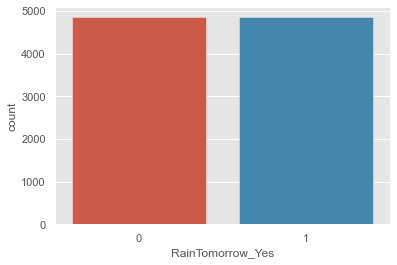

In [63]:
#Checking the count of primary_fuel

print(y.value_counts())
sns.countplot(y)
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### Feature Reduction

##### Weight of evidence & information value

In [64]:
df_final=pd.concat([x,y],axis=1)

In [65]:
df_final

,Cloud3pm,Cloud9am,Day,Evaporation,Humidity3pm,Humidity9am,Location,MaxTemp,MinTemp,Month,Pressure3pm,Pressure9am,RainToday_Yes,Rainfall,Sunshine,Temp3pm,Temp9am,WindDir3pm,WindDir9am,WindGustDir,WindGustSpeed,WindSpeed3pm,WindSpeed9am,Year,RainTomorrow_Yes
0,4.304692,8.000000,1,0.016708,22.000000,71.000000,1.000000,22.900000,13.400000,12,1007.100000,1007.700000,0,0.787183,-0.120935,21.800000,16.900000,14.000000,13.000000,13.000000,0.574142,24.000000,0.909985,2008,0
1,4.304692,4.308583,2,0.016708,25.000000,44.000000,1.000000,25.100000,7.400000,12,1007.800000,1010.600000,0,-0.650603,-0.120935,24.300000,17.200000,15.000000,6.000000,14.000000,0.574142,22.000000,-0.848113,2008,0
2,2.000000,4.308583,3,0.016708,30.000000,38.000000,1.000000,25.700000,12.900000,12,1008.700000,1007.600000,0,-0.650603,-0.120935,23.200000,21.000000,15.000000,13.000000,15.000000,0.722050,26.000000,0.827976,2008,0
3,4.304692,4.308583,4,0.016708,16.000000,45.000000,1.000000,28.000000,9.200000,12,1012.800000,1017.600000,0,-0.650603,-0.120935,26.500000,18.100000,0.000000,9.000000,4.000000,-1.160251,9.000000,0.076478,2008,0
4,8.000000,7.000000,5,0.016708,33.000000,82.000000,1.000000,32.300000,17.500000,12,1006.000000,1010.800000,0,1.150236,-0.120935,29.700000,17.800000,7.000000,1.000000,13.000000,0.345458,20.000000,-0.400649,2008,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9695,4.304692,4.308583,22,0.016708,29.425256,71.318942,7.000000,29.048515,9.880409,8,1015.163485,1017.673655,0,-0.576054,-0.120935,28.152832,16.237883,5.574744,7.468431,6.956825,0.134957,23.468431,-1.291469,2014,1
9696,4.326743,4.330602,5,0.024394,39.057269,76.122719,7.024544,32.015544,19.413090,12,1015.144967,1017.658326,0,1.819510,-0.123003,31.593455,22.008181,1.016362,4.008181,12.959094,1.854707,9.049087,-1.220885,2014,1
9697,3.885439,4.885439,28,0.690093,44.193791,66.154176,5.383297,31.611884,19.285439,11,1003.806638,1008.786830,0,-0.650603,-0.834010,30.938758,24.992934,1.268736,10.770878,11.537473,0.530695,7.806209,-0.457093,2013,1
9698,6.772015,8.000000,5,0.016708,78.158022,91.465018,1.000000,11.600000,5.958685,6,1006.453498,1008.083293,1,1.857666,-0.120935,11.469300,9.631604,8.455971,6.306996,8.455971,-0.007786,17.613993,-0.118870,2009,1


In [66]:
def calculate_woe_iv(dataset, feature, target):
    lst = []
    
    for i in range(dataset[feature].nunique()):
        val = list(dataset[feature].unique())[i]
        lst.append({
            'Value': val,
            'All': dataset[dataset[feature] == val].count()[feature],
            'Good': dataset[(dataset[feature] == val) & (dataset[target] == 0)].count()[feature],
            'Bad': dataset[(dataset[feature] == val) & (dataset[target] == 1)].count()[feature]
        })
        
    dset = pd.DataFrame(lst)
    dset['Distr_Good'] = dset['Good'] / dset['Good'].sum()
    dset['Distr_Bad'] = dset['Bad'] / dset['Bad'].sum()
    dset['WoE'] = np.log(dset['Distr_Good'] / dset['Distr_Bad'])
    dset = dset.replace({'WoE': {np.inf: 0, -np.inf: 0}})
    dset['IV'] = (dset['Distr_Good'] - dset['Distr_Bad']) * dset['WoE']
    iv = dset['IV'].sum()
    
    dset = dset.sort_values(by='WoE')
    
    return dset, iv

In [67]:
for col in df_final.columns:
    if col == 'RainTomorrow_Yes': continue
    else:
        print('WoE and IV for column: {}'.format(col))
        df, iv = calculate_woe_iv(df_final, col, 'RainTomorrow_Yes')
        print('IV score: {:.2f}'.format(iv))
        print('\n')

WoE and IV for column: Cloud3pm
IV score: 1.27


WoE and IV for column: Cloud9am
IV score: 1.00


WoE and IV for column: Day
IV score: 0.04


WoE and IV for column: Evaporation
IV score: 0.56


WoE and IV for column: Humidity3pm
IV score: 1.63


WoE and IV for column: Humidity9am
IV score: 1.14


WoE and IV for column: Location
IV score: 0.24


WoE and IV for column: MaxTemp
IV score: 0.95


WoE and IV for column: MinTemp
IV score: 0.93


WoE and IV for column: Month
IV score: 0.12


WoE and IV for column: Pressure3pm
IV score: 0.83


WoE and IV for column: Pressure9am
IV score: 0.85


WoE and IV for column: RainToday_Yes
IV score: 0.21


WoE and IV for column: Rainfall
IV score: 0.54


WoE and IV for column: Sunshine
IV score: 0.77


WoE and IV for column: Temp3pm
IV score: 0.99


WoE and IV for column: Temp9am
IV score: 0.92


WoE and IV for column: WindDir3pm
IV score: 0.54


WoE and IV for column: WindDir9am
IV score: 0.61


WoE and IV for column: WindGustDir
IV score: 0.49


WoE a

In [68]:
l_iv= x.columns.difference(['Year'])

### RFE

In [69]:
rfe = RFE(RandomForestClassifier(), n_features_to_select=14).fit(x,y)

In [70]:
l2_rfe = x.columns[rfe.get_support()]

In [71]:
l2_rfe

Index(['Cloud3pm', 'Cloud9am', 'Humidity3pm', 'Humidity9am', 'MaxTemp', 'MinTemp', 'Pressure3pm',
       'Rainfall', 'Sunshine', 'Temp3pm', 'Temp9am', 'WindGustSpeed', 'WindSpeed3pm',
       'WindSpeed9am'],
      dtype='object')

### SKB

In [72]:
SKB = SelectKBest(f_classif, k=14).fit(x, y )

In [73]:
l3_skb = x.columns[SKB.get_support()]

In [74]:
l3_skb

Index(['Cloud3pm', 'Cloud9am', 'Evaporation', 'Humidity3pm', 'Humidity9am', 'MaxTemp', 'MinTemp',
       'Pressure3pm', 'Pressure9am', 'RainToday_Yes', 'Rainfall', 'Sunshine', 'Temp3pm',
       'WindGustSpeed'],
      dtype='object')

In [75]:
list(set(list(l_iv)+list(l2_rfe)+list(l3_skb)))

['Temp3pm',
 'WindDir9am',
 'Temp9am',
 'WindSpeed9am',
 'WindGustDir',
 'WindGustSpeed',
 'Evaporation',
 'Cloud9am',
 'Pressure3pm',
 'WindSpeed3pm',
 'Location',
 'Humidity3pm',
 'Humidity9am',
 'Sunshine',
 'MinTemp',
 'MaxTemp',
 'Month',
 'Rainfall',
 'Pressure9am',
 'RainToday_Yes',
 'Cloud3pm',
 'Day',
 'WindDir3pm']

In [89]:
final_list= [#'Temp3pm',
 'WindDir9am',
 #'Temp9am',
 'WindSpeed9am',
 'WindGustDir',
 'WindGustSpeed',
 'Evaporation',
 'Cloud9am',
 'Pressure3pm',
 'WindSpeed3pm',
 'Location',
 'Humidity3pm',
 'Humidity9am',
 'Sunshine',
 'MinTemp',
 'MaxTemp',
 'Month',
 'Rainfall',
 #'Pressure9am',
 'RainToday_Yes',
 'Cloud3pm',
 'Day',
 'WindDir3pm']

### Standarization

In [77]:
sc= StandardScaler()
x = pd.DataFrame(sc.fit_transform(x), columns = x.columns)
x

,Cloud3pm,Cloud9am,Day,Evaporation,Humidity3pm,Humidity9am,Location,MaxTemp,MinTemp,Month,Pressure3pm,Pressure9am,RainToday_Yes,Rainfall,Sunshine,Temp3pm,Temp9am,WindDir3pm,WindDir9am,WindGustDir,WindGustSpeed,WindSpeed3pm,WindSpeed9am,Year
0,-0.220066,1.364328,-1.665952,0.120687,-1.766734,0.010273,-1.453699,-0.086449,0.006453,1.815823,-1.401100,-1.714181,-0.583382,0.539393,0.104998,-0.019047,-0.151639,1.423428,1.339958,1.245848,0.472451,0.728774,0.904103,-1.768530
1,-0.220066,-0.184943,-1.551164,0.120687,-1.610638,-1.613563,-1.453699,0.288447,-1.106364,1.815823,-1.275254,-1.196669,-0.583382,-0.830084,0.104998,0.415753,-0.097211,1.655804,-0.250019,1.443971,0.472451,0.511481,-0.897791,-1.768530
2,-1.245187,-0.184943,-1.436376,0.120687,-1.350477,-1.974415,-1.453699,0.390691,-0.086282,1.815823,-1.113452,-1.732027,-0.583382,-0.830084,0.104998,0.224441,0.592201,1.655804,1.339958,1.642094,0.621234,0.946066,0.820051,-1.768530
3,-0.220066,-0.184943,-1.321588,0.120687,-2.078926,-1.553420,-1.453699,0.782628,-0.772519,1.815823,-0.376355,0.052499,-0.583382,-0.830084,0.104998,0.798377,0.066071,-1.829842,0.431400,-0.537258,-1.272202,-0.900919,0.049832,-1.768530
4,1.423595,0.944633,-1.206800,0.120687,-1.194381,0.671836,-1.453699,1.515380,0.766878,1.815823,-1.598858,-1.160978,-0.583382,0.885198,0.104998,1.354922,0.011643,-0.203207,-1.385716,1.245848,0.242414,0.294189,-0.439180,-1.768530
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9695,-0.220066,-0.184943,0.744595,0.120687,-1.380382,0.029455,0.570200,0.961303,-0.646324,0.555737,0.048551,0.065643,-0.583382,-0.759076,0.104998,1.085838,-0.271763,-0.534403,0.083520,0.048557,0.030668,0.671021,-1.352191,0.936625
9696,-0.210258,-0.175702,-1.206800,0.128724,-0.879209,0.318364,0.578479,1.466907,1.121698,1.815823,0.045222,0.062907,-0.583382,1.522674,0.102890,1.684231,0.775110,-1.593663,-0.702439,1.237743,1.760591,-0.895586,-1.279848,0.936625
9697,-0.406549,0.057161,1.433323,0.824776,-0.611945,-0.281165,0.024860,1.398120,1.098023,1.500801,-1.993180,-1.520234,-0.583382,-0.830084,-0.621885,1.570367,1.316617,-1.535018,0.833636,0.956088,0.428747,-1.030619,-0.497030,0.485766
9698,0.877391,1.364328,-1.206800,0.120687,1.155284,1.241082,-1.453699,-2.012052,-1.373684,-0.074306,-1.517328,-1.645782,1.714143,1.559017,0.104998,-1.815763,-1.470304,0.135126,-0.180288,0.345572,-0.112919,0.034958,-0.150382,-1.317671


### VIF check Multicollinarity

In [90]:
x = x[final_list]
y = y

In [91]:
vif = pd.DataFrame()
vif["VIF_Factor"] = [variance_inflation_factor(x.values, i) for i in range(x.shape[1])]
vif["features"] = x.columns

In [92]:
vif.sort_values(by='VIF_Factor', ascending=False, inplace=True)
vif

,VIF_Factor,features
13,5.905458,MaxTemp
12,5.126526,MinTemp
15,4.512553,Rainfall
16,3.637294,RainToday_Yes
9,3.074659,Humidity3pm
10,2.729435,Humidity9am
3,2.199324,WindGustSpeed
11,2.169724,Sunshine
5,2.121075,Cloud9am
1,2.077124,WindSpeed9am


-------------------------------------------------------------------------------------------------------------------------------

## ML Alogs

In [95]:
# get best random state
lr=LogisticRegression()
for i in range(0,100):
    x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=i,test_size=0.2)
    lr.fit(x_train,y_train)
    pred_train=lr.predict(x_train)
    pred_test=lr.predict(x_test)
    if (accuracy_score(pred_train,y_train)*100)>=(accuracy_score(y_test,pred_test)*100):
        print("At random state ",i," The model performs very well")
        print("Training accuracy_score is :",round(accuracy_score(y_train,pred_train)*100,1))
        print("Testing accuracy_score is:",round(accuracy_score(y_test,pred_test)*100,1),  '\n\n')

At random state  1  The model performs very well
Training accuracy_score is : 79.1
Testing accuracy_score is: 79.0 


At random state  4  The model performs very well
Training accuracy_score is : 79.2
Testing accuracy_score is: 78.2 


At random state  5  The model performs very well
Training accuracy_score is : 79.2
Testing accuracy_score is: 78.4 


At random state  6  The model performs very well
Training accuracy_score is : 79.3
Testing accuracy_score is: 78.3 


At random state  7  The model performs very well
Training accuracy_score is : 79.1
Testing accuracy_score is: 78.5 


At random state  10  The model performs very well
Training accuracy_score is : 79.5
Testing accuracy_score is: 77.2 


At random state  12  The model performs very well
Training accuracy_score is : 79.1
Testing accuracy_score is: 78.8 


At random state  14  The model performs very well
Training accuracy_score is : 79.1
Testing accuracy_score is: 78.2 


At random state  15  The model performs very well
Tra

#### Split the data

In [96]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=85)

### Logistic Regression

In [97]:
lr.fit(x_train,y_train)
pred_train=lr.predict(x_train)
pred_test=lr.predict(x_test)
score_acc=accuracy_score(y_test,pred_test)
print('Auc test: ',score_acc)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))

Auc test:  0.790721649484536
Confusion Matrix:  
 [[792 188]
 [218 742]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.78      0.81      0.80       980
           1       0.80      0.77      0.79       960

    accuracy                           0.79      1940
   macro avg       0.79      0.79      0.79      1940
weighted avg       0.79      0.79      0.79      1940



#### Cross Validation

In [98]:
for i in range(3,11):
    cvs=cross_val_score(lr,x,y,cv=i)
    cvs_mean=cvs.mean()
    cvs_std=cvs.std()
    print ("At cv: ",i)
    print ("Cross validation score is : ",cvs_mean*100)
    print ("Cross validation score_std is : ", cvs_std*100)
    print ("Auc Score is : ",score_acc*100)
    print ("\n")

At cv:  3
Cross validation score is :  73.58817984729346
Cross validation score_std is :  6.318418825257393
Auc Score is :  79.0721649484536


At cv:  4
Cross validation score is :  74.4639175257732
Cross validation score_std is :  5.120744229973457
Auc Score is :  79.0721649484536


At cv:  5
Cross validation score is :  72.79381443298969
Cross validation score_std is :  7.283882713964858
Auc Score is :  79.0721649484536


At cv:  6
Cross validation score is :  74.58940409347056
Cross validation score_std is :  7.100419787920482
Auc Score is :  79.0721649484536


At cv:  7
Cross validation score is :  74.77511429032832
Cross validation score_std is :  7.253671342646253
Auc Score is :  79.0721649484536


At cv:  8
Cross validation score is :  74.81591239297055
Cross validation score_std is :  7.218319100841006
Auc Score is :  79.0721649484536


At cv:  9
Cross validation score is :  75.04298475249529
Cross validation score_std is :  8.45959058325633
Auc Score is :  79.0721649484536


A

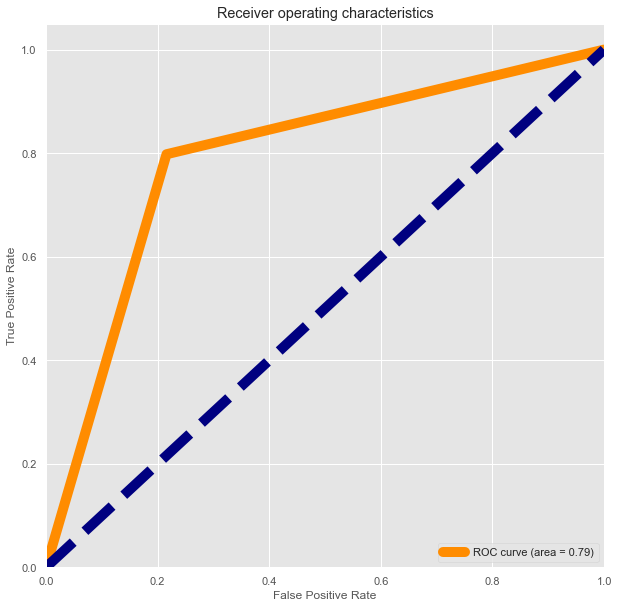

In [99]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### Decision Tree

In [111]:
#Finding the best random state:

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state =i)
    dtc=DecisionTreeClassifier()
    dtc.fit(x_train,y_train)
    pred = dtc.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.8515463917525773  on Random_state  61


In [112]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state = RS)

dtc.fit(x_train,y_train)
pred_train=dtc.predict(x_train)
pred_test=dtc.predict(x_test)
score_train=roc_auc_score(y_train,pred_train)
score_test=roc_auc_score(y_test,pred_test)
score_acc=accuracy_score(y_test,pred_test)
print('Auc test: ',score_acc)
print('Roc_Auc Score_train: ',score_train)
print('Roc_Auc Score_test: ',score_test)
print('Confusion Matrix: ' ,'\n','\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(dtc,x,y,cv=10).mean())

Auc test:  0.8536082474226804
Roc_Auc Score_train:  1.0
Roc_Auc Score_test:  0.8537104373955033
Confusion Matrix:  
 
 [[831 130]
 [154 825]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.84      0.86      0.85       961
           1       0.86      0.84      0.85       979

    accuracy                           0.85      1940
   macro avg       0.85      0.85      0.85      1940
weighted avg       0.85      0.85      0.85      1940

CV  :  0.7720618556701031


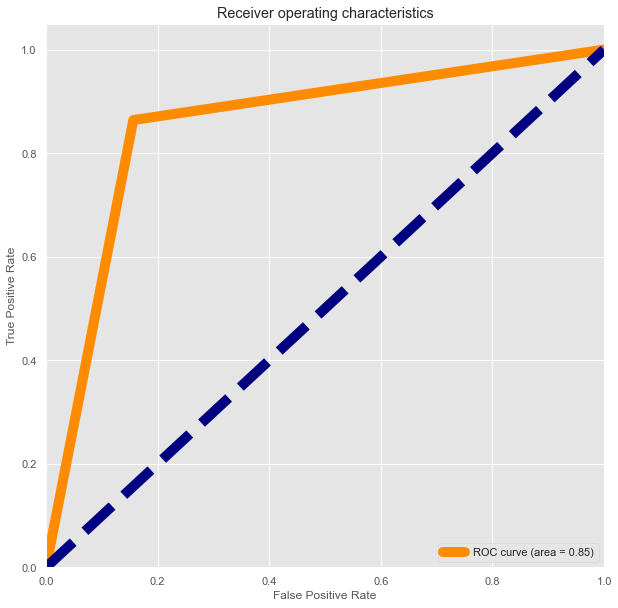

In [113]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### SVM

In [105]:
#Finding the best random state:

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state =i)
    svc=SVC()
    svc.fit(x_train, y_train)
    pred = svc.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.8716494845360825  on Random_state  34


In [106]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state = RS)

svc.fit(x_train,y_train)
pred_train=svc.predict(x_train)
pred_test=svc.predict(x_test)
score_test=roc_auc_score(y_test,pred_test)
score_train=roc_auc_score(y_train,pred_train)
score_acc=accuracy_score(y_test,pred_test)
print('Auc test: ',score_acc)
print('Roc_Auc train: ',score_train)
print('Roc_Auc test: ',score_test)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(svc,x,y,cv=10).mean())

Auc test:  0.8716494845360825
Roc_Auc train:  0.8822993075908196
Roc_Auc test:  0.8718515036094497
Confusion Matrix:  
 [[862 135]
 [114 829]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.88      0.86      0.87       997
           1       0.86      0.88      0.87       943

    accuracy                           0.87      1940
   macro avg       0.87      0.87      0.87      1940
weighted avg       0.87      0.87      0.87      1940

CV  :  0.7898969072164947


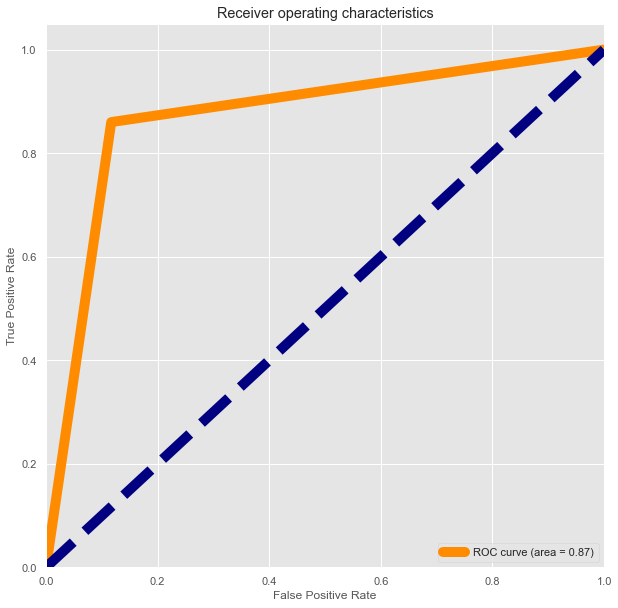

In [107]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### KNN

In [114]:
#Finding the best random state:

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state =i)
    knn=KNeighborsClassifier()
    knn.fit(x_train, y_train)
    pred = knn.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.8706185567010309  on Random_state  68


In [115]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state = RS)

knn.fit(x_train,y_train)
pred_train=knn.predict(x_train)
pred_test=knn.predict(x_test)
score_test=roc_auc_score(y_test,pred_test)
score_train=roc_auc_score(y_train,pred_train)
score_acc=accuracy_score(y_test,pred_test)
print('Auc test: ',score_acc)
print('Roc_Auc train: ',score_train)
print('Roc_Auc test: ',score_test)
print('Auccuracy test: ',score_acc)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(knn,x,y,cv=10).mean())

Auc test:  0.8706185567010309
Roc_Auc train:  0.8966308311012082
Roc_Auc test:  0.8688416960912839
Auccuracy test:  0.8706185567010309
Confusion Matrix:  
 [[740 211]
 [ 40 949]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.95      0.78      0.85       951
           1       0.82      0.96      0.88       989

    accuracy                           0.87      1940
   macro avg       0.88      0.87      0.87      1940
weighted avg       0.88      0.87      0.87      1940

CV  :  0.7799999999999999


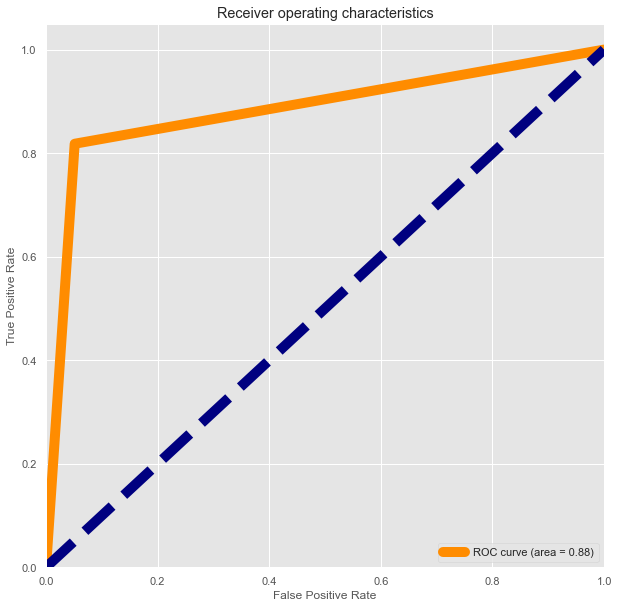

In [116]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### Ensembles Techniques

### Random Forest Classifier

In [117]:
#Finding the best random state

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state =i)
    rfc=RandomForestClassifier()
    rfc.fit(x_train, y_train)
    pred = rfc.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.9154639175257732  on Random_state  83


In [118]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state = RS)

rfc.fit(x_train,y_train)
pred_train=rfc.predict(x_train)
pred_test=rfc.predict(x_test)
score_test=roc_auc_score(y_test,pred_test)
score_train=roc_auc_score(y_train,pred_train)
score_acc=accuracy_score(y_test,pred_test)
print('Auc test: ',score_acc)
print('Roc_Auc train: ',score_train)
print('Roc_Auc test: ',score_test)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(rfc,x,y,cv=10).mean())

Auc test:  0.9164948453608247
Roc_Auc train:  1.0
Roc_Auc test:  0.9165497448979593
Confusion Matrix:  
 [[893  87]
 [ 75 885]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.92      0.91      0.92       980
           1       0.91      0.92      0.92       960

    accuracy                           0.92      1940
   macro avg       0.92      0.92      0.92      1940
weighted avg       0.92      0.92      0.92      1940

CV  :  0.8264948453608248


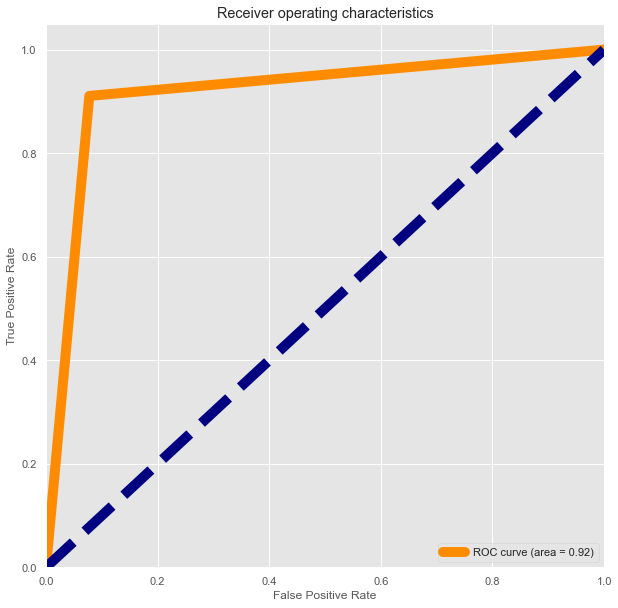

In [119]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### GBC

In [120]:
#Finding the best random state

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state =i)
    gbc=GradientBoostingClassifier()
    gbc.fit(x_train, y_train)
    pred = gbc.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.8876288659793814  on Random_state  83


In [121]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state = RS)

gbc.fit(x_train,y_train)
pred_train=gbc.predict(x_train)
pred_test=gbc.predict(x_test)
score_test=roc_auc_score(y_test,pred_test)
score_train=roc_auc_score(y_train,pred_train)
score_acc=accuracy_score(y_test,pred_test)
print('Acc test: ',score_acc)
print('Roc_Auc train: ',score_train)
print('Roc_Auc test: ',score_test)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(gbc,x,y,cv=10).mean())

Acc test:  0.8876288659793814
Roc_Auc train:  0.8852005739224009
Roc_Auc test:  0.8874893707482994
Confusion Matrix:  
 [[883  97]
 [121 839]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.88      0.90      0.89       980
           1       0.90      0.87      0.89       960

    accuracy                           0.89      1940
   macro avg       0.89      0.89      0.89      1940
weighted avg       0.89      0.89      0.89      1940

CV  :  0.7654639175257734


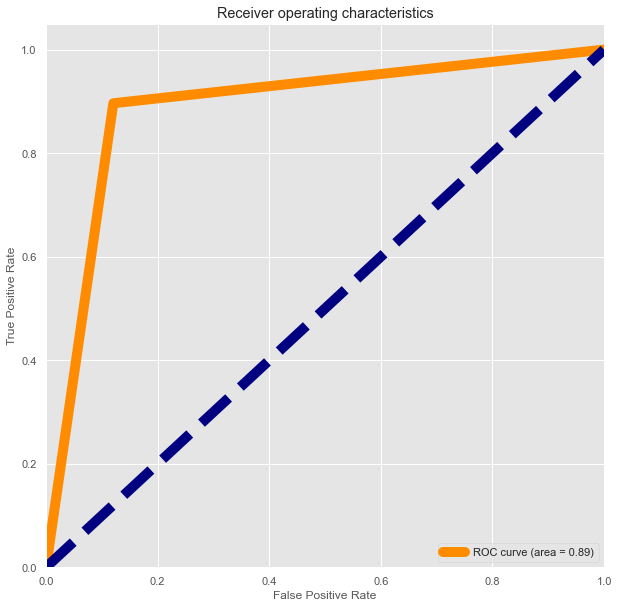

In [122]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

### XGBoost

In [123]:
#Finding the best random state

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state =i)
    xgb=XGBClassifier()
    xgb.fit(x_train, y_train)
    pred = xgb.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.9195876288659793  on Random_state  43


In [124]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.2, random_state = RS)

xgb.fit(x_train,y_train)
pred_train=xgb.predict(x_train)
pred_test=xgb.predict(x_test)
score_test=roc_auc_score(y_test,pred_test)
score_train=roc_auc_score(y_train,pred_train)
score_acc=accuracy_score(y_test,pred_test)
print('Acc test: ',score_acc)
print('Roc_Auc train: ',score_train)
print('Roc_Auc test: ',score_test)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(xgb,x,y,cv=10).mean())

Acc test:  0.9195876288659793
Roc_Auc train:  0.9958696902862229
Roc_Auc test:  0.9197433300135308
Confusion Matrix:  
 [[900  61]
 [ 95 884]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.90      0.94      0.92       961
           1       0.94      0.90      0.92       979

    accuracy                           0.92      1940
   macro avg       0.92      0.92      0.92      1940
weighted avg       0.92      0.92      0.92      1940

CV  :  0.7727835051546392


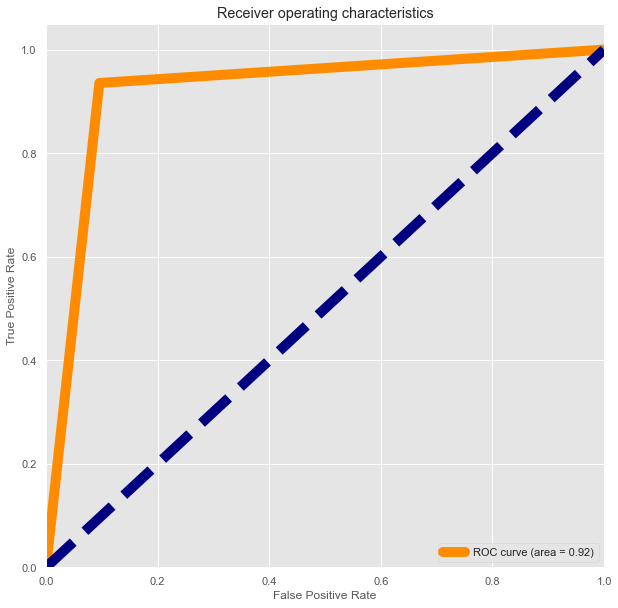

In [125]:
# ROC curve 
fpr,tpr,threshold=roc_curve(pred_test,y_test)
roc_auc=auc(fpr,tpr)

plt.figure(figsize=(10,10))
plt.plot(fpr,tpr,color='darkorange',lw=10,label='ROC curve (area = %0.2f)' %roc_auc)
plt.plot([0,1],[0,1],color='navy',lw=10,linestyle='--')
plt.xlim([0.0,1.0])
plt.ylim([0.0,1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristics')
plt.legend(loc="lower right")
plt.show()

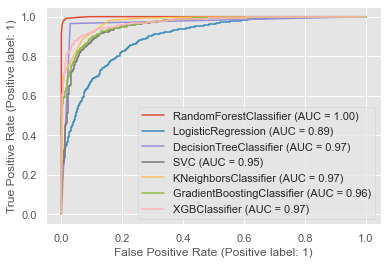

In [126]:
# Plotting AUC-ROC Curve for all the models used here 
 

disp = plot_roc_curve(rfc,x_test,y_test)
plot_roc_curve(lr, x_test, y_test, ax=disp.ax_)    
plot_roc_curve(dtc,x_test, y_test, ax=disp.ax_)
plot_roc_curve(svc, x_test, y_test, ax=disp.ax_)
plot_roc_curve(knn, x_test, y_test, ax=disp.ax_)
plot_roc_curve(gbc, x_test, y_test, ax=disp.ax_)
plot_roc_curve(xgb, x_test, y_test, ax=disp.ax_)

plt.legend(prop={'size':11}, loc='lower right')
plt.show()

-------------------------------------------------------------------------------------------------------------------------------

##### I will choose RandomForest Classifer as it have Roc_Auc train:  100%  , Roc_Auc test:  91.6%    with 83%  CV mean.

-------------------------------------------------------------------------------------------------------------------------------

#### Hyperparameter Tuning 

In [147]:
# tunning RandomForest Classifier
from sklearn.model_selection import RandomizedSearchCV

param_rfc={'n_estimators':[100,300,500,700,1000,1200],'max_depth':range(2,20,1),'max_features':['auto','log2'],
           'criterion':['gini','entropy'],'min_samples_leaf':range(1,10,1),'min_samples_split':range(2,10,1)}

rfc_model= RandomizedSearchCV(RandomForestClassifier(),param_rfc,n_iter=100,cv=10,n_jobs=-1,scoring='roc_auc',verbose=True).fit(x_train,y_train)

Fitting 10 folds for each of 100 candidates, totalling 1000 fits


In [148]:
rfc_model.best_params_

{'n_estimators': 700,
 'min_samples_split': 8,
 'min_samples_leaf': 1,
 'max_features': 'auto',
 'max_depth': 17,
 'criterion': 'entropy'}

In [149]:
rfc_model.best_score_

0.9570893574942698

In [150]:
rfc_model_final=RandomForestClassifier(n_estimators= 700,min_samples_split=8,min_samples_leaf=1,max_features='auto',
                                       max_depth= 17,criterion='entropy',random_state=83).fit(x_train,y_train)

In [151]:
pred_train=rfc_model_final.predict(x_train)
pred_test=rfc_model_final.predict(x_test)
score_acc=accuracy_score(y_test,pred_test)
print('Auc test: ',score_acc)
print('Confusion Matrix: ' ,'\n',confusion_matrix(y_test,pred_test))
print('Classification Report: ','\n',classification_report(y_test,pred_test))
print('CV  : ',cross_val_score(rfc_model_final,x,y,cv=10).mean())

Auc test:  0.9118556701030928
Confusion Matrix:  
 [[876  85]
 [ 86 893]]
Classification Report:  
               precision    recall  f1-score   support

           0       0.91      0.91      0.91       961
           1       0.91      0.91      0.91       979

    accuracy                           0.91      1940
   macro avg       0.91      0.91      0.91      1940
weighted avg       0.91      0.91      0.91      1940

CV  :  0.8190721649484536


##### After tunning the main rfc model is still te best so i will use it instead of the tunning model; i used randomSearch instead of Gridsearch due to the time wasting.

-------------------------------------------------------------------------------------------------------------------------------

## Saving Model

In [152]:
#Saving the model using .pkl
import joblib
joblib.dump(rfc,"Rainfall_prediction_class.pkl")

['Rainfall_prediction_class.pkl']

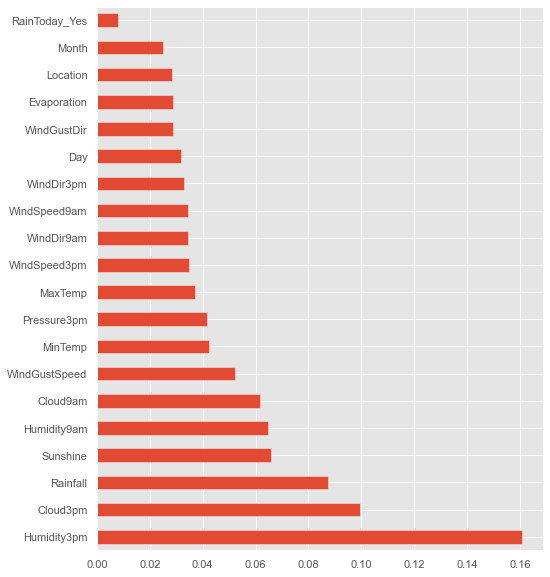

In [153]:
#Checking Feature Importance with XGBoost Model

feat_importances = pd.Series(rfc.feature_importances_, index=x.columns)
feat_importances.nlargest(100).plot(kind='barh',figsize=(8,10))
plt.show()

In [154]:
# load model and get predictions

model=joblib.load("Rainfall_prediction_class.pkl")

#Predict

prediction = model.predict(x_test)

prediction

array([0, 0, 0, ..., 1, 1, 1], dtype=uint8)

In [155]:
pd.DataFrame([model.predict(x_test)[:], y_test[:]], index = ['Predicted', 'Original'])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,...,1590,1591,1592,1593,1594,1595,1596,1597,1598,1599,1600,1601,1602,1603,1604,1605,1606,1607,1608,1609,1610,1611,1612,1613,1614,1615,1616,1617,1618,1619,1620,1621,1622,1623,1624,1625,1626,1627,1628,1629,1630,1631,1632,1633,1634,1635,1636,1637,1638,1639,1640,1641,1642,1643,1644,1645,1646,1647,1648,1649,1650,1651,1652,1653,1654,1655,1656,1657,1658,1659,1660,1661,1662,1663,1664,1665,1666,1667,1668,1669,1670,1671,1672,1673,1674,1675,1676,1677,1678,1679,1680,1681,1682,1683,1684,1685,1686,1687,1688,1689,1690,1691,1692,1693,1694,1695,1696,1697,1698,1699,1700,1701,1702,1703,1704,1705,1706,1707,1708,1709,1710,1711,1712,1713,1714,1715,1716,1717,1718,1719,1720,1721,1722,1723,1724,1725,1726,1727,1728,1729,1730,1731,1732,1733,1734,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1748,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1762,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1832,1833,1834,1835,1836,1837,1838,1839,1840,1841,1842,1843,1844,1845,1846,1847,1848,1849,1850,1851,1852,1853,1854,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,1920,1921,1922,1923,1924,1925,1926,1927,1928,1929,1930,1931,1932,1933,1934,1935,1936,1937,1938,1939
Predicted,0,0,0,1,1,1,1,0,1,0,1,0,0,1,1,1,0,1,0,1,0,1,1,0,1,1,1,0,1,0,1,1,0,0,1,0,0,0,1,0,0,1,1,0,1,0,0,0,0,0,0,0,1,1,1,0,1,0,1,0,1,0,0,0,0,1,1,1,1,1,1,0,1,0,1,0,1,0,1,1,1,1,1,1,1,0,0,1,0,0,1,1,1,0,0,0,0,0,1,1,1,0,0,0,1,1,0,0,0,1,0,1,0,1,1,1,1,1,0,0,0,1,0,1,1,1,1,1,1,0,1,1,0,0,1,1,0,0,1,0,1,0,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,0,0,0,1,1,0,1,0,0,1,1,1,1,0,0,0,0,1,1,0,0,1,1,1,0,0,0,0,1,0,0,0,1,0,0,1,1,0,1,1,0,1,0,0,1,0,0,1,0,1,0,1,1,1,0,0,0,1,0,0,1,0,1,1,0,0,0,0,1,0,1,1,0,1,1,0,0,0,1,1,0,1,0,1,1,0,1,1,0,1,1,1,1,0,0,1,0,1,1,1,0,1,0,1,0,0,0,1,1,1,0,0,1,1,1,1,1,1,1,1,1,0,1,1,1,0,1,1,1,0,0,0,1,1,1,1,1,1,0,0,0,1,0,0,1,1,1,1,1,0,1,1,1,0,0,0,1,1,0,1,0,0,1,0,0,0,1,1,1,0,0,1,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,...,1,0,0,1,1,0,0,1,0,0,0,0,1,0,1,1,0,0,1,0,1,1,0,0,1,1,1,0,1,1,0,1,1,0,0,1,1,0,0,0,1,0,1,0,1,0,1,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,1,1,1,1,1,0,0,0,1,0,0,1,1,0,0,0,0,1,1,0,1,0,0,0,1,0,1,1,0,1,1,1,1,1,0,1,1,1,1,1,0,1,0,0,1,1,0,0,0,1,1,0,0,0,0,0,1

-------------------------------------------------------------------------------------------------------------------------------

-------------------------------------------------------------------------------------------------------------------------------

## Regression Problem
#### Prediction for Rainfall

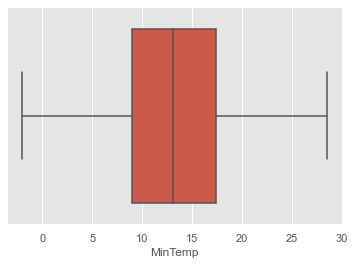

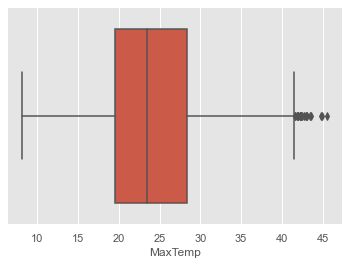

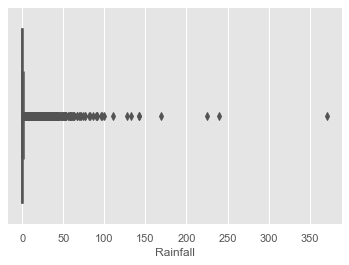

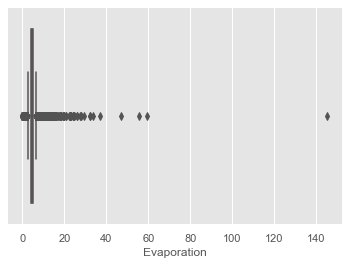

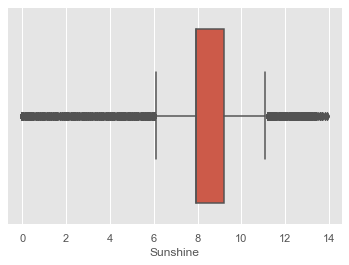

...

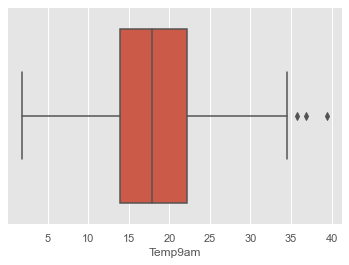

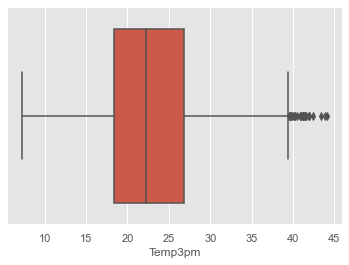

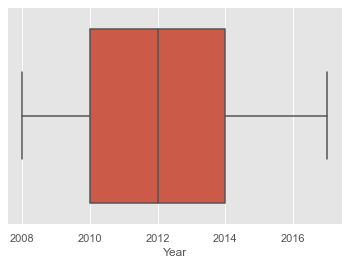

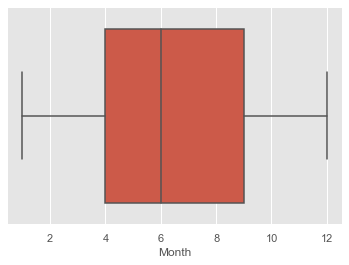

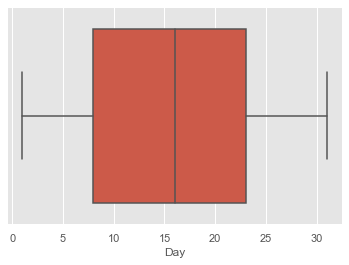

In [160]:
# Check outliers using boxplot
for col in num_reg.columns:
    sns.boxplot(num_reg[col])
    plt.show()

In [161]:
### use Z-score method
outliers=df_reg[num_reg.columns.difference(['MinTemp','Cloud9am','Cloud3pm','Year','Month','Day'])]
z=np.abs(zscore(outliers))
dfreg_new=df_reg[(z<3).all(axis=1)]
dfreg_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,7.924249,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.315844,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,7.924249,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.324085,4.315844,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,7.924249,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.324085,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,7.924249,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.324085,4.315844,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,7.924249,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6757,Uluru,2.8,23.400000,0.0,4.6,7.924249,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,4.324085,4.315844,10.1,22.4,No,No,2017,6,21
6758,Uluru,3.6,25.300000,0.0,4.6,7.924249,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,4.324085,4.315844,10.9,24.5,No,No,2017,6,22
6759,Uluru,5.4,26.900000,0.0,4.6,7.924249,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,4.324085,4.315844,12.5,26.1,No,No,2017,6,23
6760,Uluru,7.8,27.000000,0.0,4.6,7.924249,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [163]:
# data loss percentage for class problem

loss_percentage_reg= ((df_reg.shape[0]- dfreg_new.shape[0])/df_reg.shape[0])*100
loss_percentage_reg

5.2687198067632846

##### It's acceptable

In [164]:
# check skew
dfreg_new.skew()

MinTemp         -0.070780
MaxTemp          0.264103
Rainfall         3.500996
Evaporation      1.123443
Sunshine        -0.905146
WindGustSpeed    0.555904
WindSpeed9am     0.688474
WindSpeed3pm     0.347552
Humidity9am     -0.229258
Humidity3pm      0.161550
Pressure9am      0.059158
Pressure3pm      0.093622
Cloud9am        -0.194053
Cloud3pm        -0.143822
Temp9am         -0.072416
Temp3pm          0.285283
Year             0.356862
Month            0.035602
Day              0.002039
dtype: float64

In [165]:
# I'll consider -0.5/0.5 is ok among features skewness and treat the others features.

skew_cols=['Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am']

In [166]:
# withing Power transformer to treat skewness
scaler = PowerTransformer()
dfreg_new[skew_cols] = scaler.fit_transform(dfreg_new[skew_cols].values)

In [167]:
# Encoding
# use getdummies for nominal features like; gelocation source and other fuel, while use ordinal encoder for target feature


encode_cols=['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']


from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

for i in encode_cols:
    dfreg_new[i]=enc.fit_transform(dfreg_new[i].values.reshape(-1,1))
    
dfreg_new=pd.get_dummies(dfreg_new,columns=['RainToday','RainTomorrow'],drop_first=True)

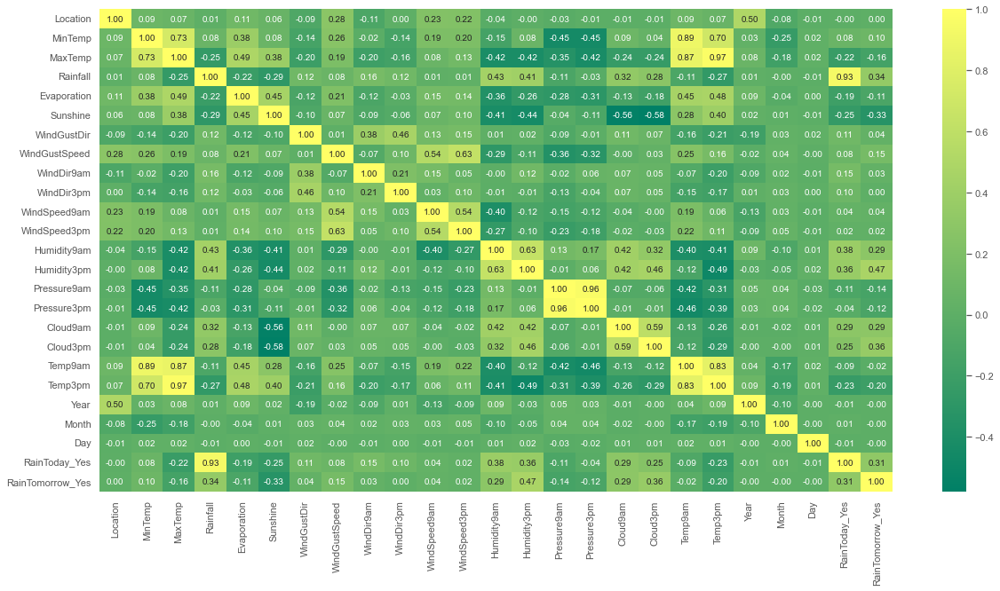

In [168]:
# heatmap correlation
plt.figure(figsize = (20,10))
sns.heatmap(dfreg_new.corr(), annot=True,cmap='summer',fmt='.2f')
plt.show()

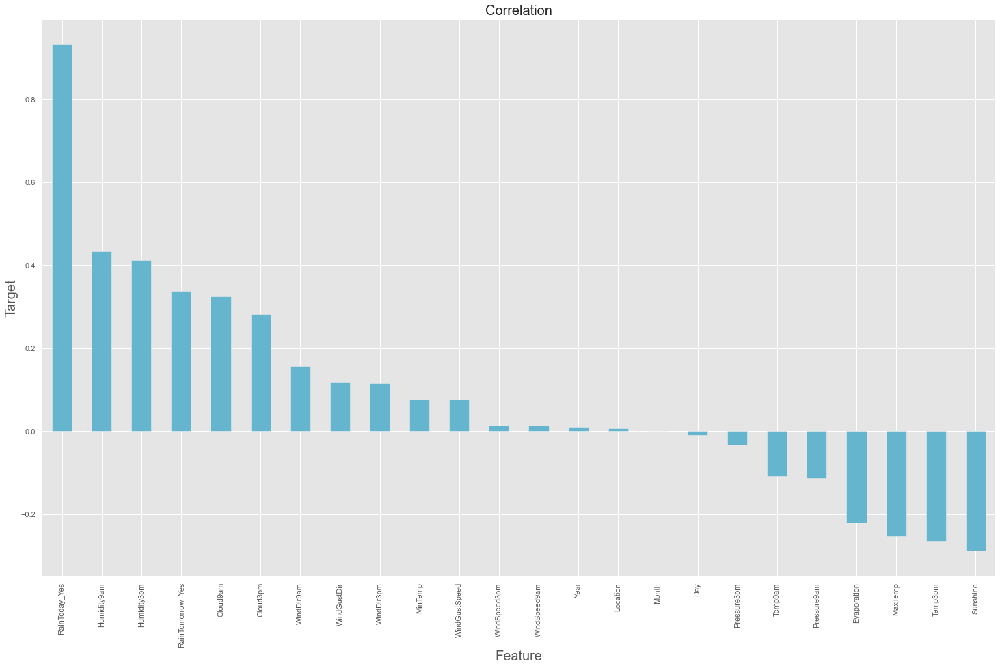

In [169]:
#Visualization of the Correlation Metrics
plt.figure(figsize = (25, 15))

dfreg_new.corr()['Rainfall'].sort_values(ascending = False).drop(['Rainfall']).plot(kind = 'bar', color = 'c')

plt.xlabel('Feature', fontsize = 20)

plt.ylabel('Target', fontsize = 20)

plt.title('Correlation', fontsize = 20)

plt.show()

We have multicollinearity. Our target Rainfall is highly correlated with RainToday and followed by Humidity 9am and Humidity 3pm. Least correlation is between rainfall and year,month,windspeen3pm,windspeed 9am,location

In [170]:
dfreg_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year,Month,Day,RainToday_Yes,RainTomorrow_Yes
0,1.0,13.4,22.900000,0.763967,0.01622,-0.120036,13.0,0.577010,13.0,14.0,0.912308,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.315844,16.9,21.8,2008,12,1,0,0
1,1.0,7.4,25.100000,-0.655428,0.01622,-0.120036,14.0,0.577010,6.0,15.0,-0.844224,22.0,44.0,25.0,1010.6,1007.8,4.324085,4.315844,17.2,24.3,2008,12,2,0,0
2,1.0,12.9,25.700000,-0.655428,0.01622,-0.120036,15.0,0.725130,13.0,15.0,0.830513,26.0,38.0,30.0,1007.6,1008.7,4.324085,2.000000,21.0,23.2,2008,12,3,0,0
3,1.0,9.2,28.000000,-0.655428,0.01622,-0.120036,4.0,-1.159383,9.0,0.0,0.080410,9.0,45.0,16.0,1017.6,1012.8,4.324085,4.315844,18.1,26.5,2008,12,4,0,0
4,1.0,17.5,32.300000,1.126644,0.01622,-0.120036,13.0,0.348011,1.0,7.0,-0.396454,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,2008,12,5,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6757,9.0,2.8,23.400000,-0.655428,0.01622,-0.120036,0.0,-0.486911,9.0,1.0,0.287627,11.0,51.0,24.0,1024.6,1020.3,4.324085,4.315844,10.1,22.4,2017,6,21,0,0
6758,9.0,3.6,25.300000,-0.655428,0.01622,-0.120036,6.0,-1.369781,9.0,3.0,0.287627,9.0,56.0,21.0,1023.5,1019.1,4.324085,4.315844,10.9,24.5,2017,6,22,0,0
6759,9.0,5.4,26.900000,-0.655428,0.01622,-0.120036,3.0,0.028493,9.0,14.0,-0.145589,9.0,53.0,24.0,1021.0,1016.8,4.324085,4.315844,12.5,26.1,2017,6,23,0,0
6760,9.0,7.8,27.000000,-0.655428,0.01622,-0.120036,9.0,-0.764274,10.0,3.0,0.287627,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,2017,6,24,0,0


-------------------------------------------------------------------------------------------------------------------------------

In [171]:
# Rainfall is the target feature now.
x = dfreg_new.drop('Rainfall',axis=1)
y = dfreg_new['Rainfall']

### Feature Reduction

#### RFE

In [172]:
rfe = RFE(LinearRegression(), n_features_to_select=12).fit(x,y)

In [173]:
l1_rfe = x.columns[rfe.get_support()]

In [174]:
l1_rfe

Index(['MinTemp', 'MaxTemp', 'Evaporation', 'WindGustSpeed', 'WindDir3pm', 'WindSpeed9am',
       'Pressure9am', 'Pressure3pm', 'Cloud3pm', 'Year', 'RainToday_Yes', 'RainTomorrow_Yes'],
      dtype='object')

#### F-regression

In [175]:
from sklearn.feature_selection import f_regression
F_values, p_values  = f_regression(x, y )

In [176]:
import itertools
f_reg_results = [(i, v, z) for i, v, z in itertools.zip_longest(x.columns, F_values,  ['%.3f' % p for p in p_values])]
f_reg_results=pd.DataFrame(f_reg_results, columns=['Variable','F_Value', 'P_Value'])

In [179]:
f_reg_results=pd.DataFrame(f_reg_results, columns=['Variable','F_Value', 'P_Value'])
f_reg_results = f_reg_results.sort_values(by=['P_Value']).head(12)

In [180]:
f_reg_results

,Variable,F_Value,P_Value
11,Humidity9am,1444.172979,0.000
18,Temp3pm,473.873605,0.000
17,Temp9am,73.546654,0.000
16,Cloud3pm,544.193241,0.000
15,Cloud9am,736.089243,0.000
13,Pressure9am,82.478870,0.000
12,Humidity3pm,1279.746196,0.000
22,RainToday_Yes,42115.165105,0.000
23,RainTomorrow_Yes,806.099890,0.000
7,WindDir9am,156.597512,0.000


In [ ]:
l2_fr=f_reg_results['Variable'].values  # CI=0.9

In [182]:
l2_fr=['Humidity9am','Temp3pm','Temp9am','Cloud3pm','Cloud9am','Pressure9am','Humidity3pm','RainToday_Yes','RainTomorrow_Yes'
       ,'WindDir9am']

### SKB

In [183]:
SKB = SelectKBest(f_classif, k=12).fit(x, y )

In [184]:
l3_skb = x.columns[SKB.get_support()]

In [185]:
l3_skb

Index(['MaxTemp', 'Evaporation', 'Sunshine', 'WindGustDir', 'WindDir9am', 'Humidity9am',
       'Humidity3pm', 'Cloud9am', 'Cloud3pm', 'Temp3pm', 'RainToday_Yes', 'RainTomorrow_Yes'],
      dtype='object')

In [186]:
list(set(list(l1_rfe)+(l2_fr)+list(l3_skb)))

['Temp3pm',
 'WindDir9am',
 'Temp9am',
 'WindSpeed9am',
 'WindGustDir',
 'WindGustSpeed',
 'WindDir3pm',
 'Evaporation',
 'Cloud9am',
 'Pressure3pm',
 'Year',
 'Humidity3pm',
 'Humidity9am',
 'Sunshine',
 'MinTemp',
 'MaxTemp',
 'RainTomorrow_Yes',
 'Pressure9am',
 'RainToday_Yes',
 'Cloud3pm']

In [200]:
final_list= [#'Temp3pm',
 'WindDir9am',
 #'Temp9am',
 'WindSpeed9am',
 'WindGustDir',
 'WindGustSpeed',
 'WindDir3pm',
 'Evaporation',
 'Cloud9am',
 'Pressure3pm',
 'Year',
 'Humidity3pm',
 'Humidity9am',
 'Sunshine',
 'MinTemp',
 'MaxTemp',
 'RainTomorrow_Yes',
 #'Pressure9am',
 'RainToday_Yes',
 'Cloud3pm']

### Standarization

In [188]:
sc= StandardScaler()
x = pd.DataFrame(sc.fit_transform(x), columns = x.columns)
x

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Year,Month,Day,RainToday_Yes,RainTomorrow_Yes
0,-1.385541,0.074456,-0.190697,0.01622,-0.120036,1.226284,0.577010,1.318903,1.373718,0.912308,0.767411,0.200995,-1.556366,-1.773767,-1.448961,1.491036,0.017750,-0.162037,-0.150053,-1.767747,1.674175,-1.674215,-0.543277,-0.534167
1,-1.385541,-1.004537,0.174802,0.01622,-0.120036,1.417254,0.577010,-0.221085,1.596886,-0.844224,0.546716,-1.391144,-1.391755,-1.265369,-1.324988,0.015099,0.017750,-0.109332,0.276409,-1.767747,1.674175,-1.560491,-0.543277,-0.534167
2,-1.385541,-0.015460,0.274483,0.01622,-0.120036,1.608224,0.725130,1.318903,1.596886,0.830513,0.988107,-1.744953,-1.117404,-1.791298,-1.165594,0.015099,-0.974568,0.558265,0.088766,-1.767747,1.674175,-1.446767,-0.543277,-0.534167
3,-1.385541,-0.680839,0.656595,0.01622,-0.120036,-0.492443,-1.159383,0.438910,-1.750632,0.080410,-0.887805,-1.332176,-1.885587,-0.038200,-0.439467,0.015099,0.017750,0.048783,0.651695,-1.767747,1.674175,-1.333044,-0.543277,-0.534167
4,-1.385541,0.811768,1.370979,0.01622,-0.120036,1.226284,0.348011,-1.321076,-0.188457,-0.396454,0.326020,0.849644,-0.952794,-1.230307,-1.643775,1.089521,1.596377,-0.003922,1.197565,-1.767747,1.674175,-1.219320,-0.543277,-0.534167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6270,1.209570,-1.831765,-0.107629,0.01622,-0.120036,-1.256322,-0.486911,0.438910,-1.527464,0.287627,-0.667109,-0.978367,-1.446625,1.188968,0.888815,0.015099,0.017750,-1.356686,-0.047702,2.179490,-0.126399,0.600263,-0.543277,-0.534167
6271,1.209570,-1.687899,0.208029,0.01622,-0.120036,-0.110504,-1.369781,0.438910,-1.081128,0.287627,-0.887805,-0.683527,-1.611236,0.996127,0.676290,0.015099,0.017750,-1.216139,0.310526,2.179490,-0.126399,0.713987,-0.543277,-0.534167
6272,1.209570,-1.364201,0.473846,0.01622,-0.120036,-0.683413,0.028493,0.438910,1.373718,-0.145589,-0.887805,-0.860431,-1.446625,0.557853,0.268950,0.015099,0.017750,-0.935045,0.583461,2.179490,-0.126399,0.827711,-0.543277,-0.534167
6273,1.209570,-0.932604,0.490460,0.01622,-0.120036,0.462405,-0.764274,0.658908,-1.081128,0.287627,-1.108500,-0.978367,-1.446625,0.277357,0.215819,-0.516541,-0.974568,-0.478268,0.566403,2.179490,-0.126399,0.941435,-0.543277,-0.534167


#### VIF check Multicollinarity

In [201]:
x = x[final_list]
y = y

In [202]:
vif = pd.DataFrame()
vif["VIF_Factor"] = [variance_inflation_factor(x.values, i) for i in range(x.shape[1])]
vif["features"] = x.columns

In [203]:
vif.sort_values(by='VIF_Factor', ascending=False, inplace=True)
vif

,VIF_Factor,features
13,5.657565,MaxTemp
12,4.748422,MinTemp
9,3.201692,Humidity3pm
10,2.576504,Humidity9am
11,2.191445,Sunshine
6,2.000109,Cloud9am
16,1.928585,Cloud3pm
1,1.797039,WindSpeed9am
3,1.723788,WindGustSpeed
5,1.667745,Evaporation


-------------------------------------------------------------------------------------------------------------------------------

### ML Algos

In [204]:
#Selecting the best random state to get maximum accuracy.
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=i)
    lr= LinearRegression()
    lr.fit(x_train,y_train)
    pred = lr.predict(x_test)
    acc = r2_score(y_test, pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.8976734882224016 seen for random state: 99


##### split the data

In [205]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.20,random_state=99)

In [206]:
lr=LinearRegression()
lr.fit(x_train,y_train)
pred_train=lr.predict(x_train)
pred_test=lr.predict(x_test)
score_train=r2_score(y_train,pred_train)
score_test=r2_score(y_test,pred_test)
mse = mean_squared_error(y_test, pred_test)

print('R2_Score_train: ',score_train)
print('R2_Score_test: ',score_test)
print('RMSE = ', np.sqrt(mse).round(4))
print('The mean absolute error', mean_absolute_error(y_test, pred_test))

R2_Score_train:  0.880006708495142
R2_Score_test:  0.8976734882224016
RMSE =  0.3162
The mean absolute error 0.20833762897254027


Text(0, 0.5, 'Predicted Y')

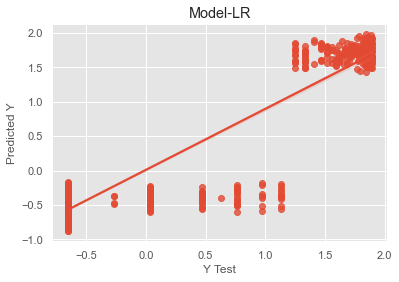

In [207]:
sns.regplot(x=y_test,y=pred_test)
plt.title("Model-LR")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')
plt.show()

#### Cross Validation

In [208]:
for i in range(2,10):
    cv_score=cross_val_score(lr,x,y,scoring='r2',cv=i)
    cv_mean= cv_score.mean()
    cv_std= cv_score.std()
    print(f'At Cross fold {i} the cv score mean is {cv_mean*100} and the cv score std is {cv_std},testing accuracy score= {score_test*100}')
    print('\n')

At Cross fold 2 the cv score mean is 88.01150626727818 and the cv score std is 0.009052621285665308,testing accuracy score= 89.76734882224015


At Cross fold 3 the cv score mean is 88.13969921534644 and the cv score std is 0.009468215200830356,testing accuracy score= 89.76734882224015


At Cross fold 4 the cv score mean is 88.11355778044138 and the cv score std is 0.015455511995474291,testing accuracy score= 89.76734882224015


At Cross fold 5 the cv score mean is 88.12693409229034 and the cv score std is 0.019611334634572458,testing accuracy score= 89.76734882224015


At Cross fold 6 the cv score mean is 88.1258211809012 and the cv score std is 0.018114792985069336,testing accuracy score= 89.76734882224015


At Cross fold 7 the cv score mean is 88.06570730436995 and the cv score std is 0.023971471347104707,testing accuracy score= 89.76734882224015


At Cross fold 8 the cv score mean is 88.03010304913809 and the cv score std is 0.026558465897131178,testing accuracy score= 89.7673488222

-------------------------------------------------------------------------------------------------------------------------------

In [209]:
#Creating list of models and another list mapped to their names
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import AdaBoostRegressor
models=[KNeighborsRegressor(),SVR(),LinearRegression(),Lasso(),Ridge(),DecisionTreeRegressor(),
       RandomForestRegressor(),AdaBoostRegressor(),GradientBoostingRegressor()]

names=['KNeighborsRegressor','SVR','LinearRegression','Lasso','Ridge','DecisionTreeRegressor',
       'RandomForestRegressor','AdaBoostRegressor','GradientBoostingRegressor']

In [210]:
def createmodels(model_list,independent,dependent,n):
    xtrain,xtest,ytrain,ytest=train_test_split(independent,dependent,test_size=0.2,random_state=99)
    name=[]
    meanabs=[]
    rootmeansqd=[]
    r2=[]
    mcv=[]
    
    #Creating models
    for i,model in enumerate(model_list):
        model.fit(xtrain,ytrain)
        p=model.predict(xtest)
        score=cross_val_score(model,independent,dependent,cv=3)
        
        #Calculating scores of the model and appending them to a list
        name.append(n[i])
        meanabs.append(np.round(mean_absolute_error(p,ytest),4))
        rootmeansqd.append(np.round(np.sqrt(mean_squared_error(p,ytest)),4))
        r2.append(np.round(r2_score(p,ytest),2))
        mcv.append(np.round(np.mean(score),4))
    
    #Creating Dataframe
    data=pd.DataFrame()
    data['Model']=name
    data['Mean Absolute Error']=meanabs
    data['Root Mean Squared Error']=rootmeansqd
    data['R2 Score']=r2
    data['Mean of Cross validaton Score']=mcv
    data.set_index('Model',inplace = True)
    return data

In [211]:
createmodels(models,x,y,names)

,Mean Absolute Error,Root Mean Squared Error,R2 Score,Mean of Cross validaton Score
Model,,,,
KNeighborsRegressor,0.2112,0.3781,8.300000e-01,0.8497
SVR,0.1802,0.3257,8.800000e-01,0.8633
LinearRegression,0.2083,0.3162,8.800000e-01,0.8814
Lasso,0.8636,0.9897,-3.255256e+35,-0.0199
Ridge,0.2084,0.3162,8.800000e-01,0.8814
DecisionTreeRegressor,0.2264,0.4763,7.700000e-01,0.6927
RandomForestRegressor,0.1997,0.3195,8.800000e-01,0.8658
AdaBoostRegressor,0.2956,0.3670,8.200000e-01,0.8623
GradientBoostingRegressor,0.1926,0.3134,8.900000e-01,0.8773


-------------------------------------------------------------------------------------------------------------------------------

##### GradientBoostingRegressor is the best model with r2=89% and CV= 87.73%

#### HyperParameter Tuning

In [214]:
# Tunning for Gradientboosting Regressor

from sklearn.model_selection import RandomizedSearchCV

params={'n_estimators':[100,300,500,700,1000,1200],'learning_rate':[0.001,0.01,0.1,1],'max_depth':range(2,20,1)
        ,'max_features':['auto','log2','sqrt'],'min_samples_leaf':range(1,10,1),'min_samples_split':range(2,10,1)
        ,'subsample': [0.7,0.9,1]}

gbr=RandomizedSearchCV(GradientBoostingRegressor(),params,scoring='r2',
                     cv =3, n_iter = 150, n_jobs=-1,verbose=3)
gbr.fit(x_train,y_train)
y_pred=gbr.predict(x_test)
print('The r2 score is:', r2_score(y_test, y_pred))
print("\n The best estimator across ALL searched params:\n", gbr.best_estimator_)
print("\n The best score across ALL searched params:\n", gbr.best_score_)
print("\n The best parameters across ALL searched params:\n",gbr.best_params_)

Fitting 3 folds for each of 150 candidates, totalling 450 fits
The r2 score is: 0.9016037136797802

 The best estimator across ALL searched params:
 GradientBoostingRegressor(learning_rate=0.01, max_depth=6, max_features='sqrt',
                          min_samples_leaf=6, min_samples_split=5,
                          n_estimators=500, subsample=0.7)

 The best score across ALL searched params:
 0.8806774528371625

 The best parameters across ALL searched params:
 {'subsample': 0.7, 'n_estimators': 500, 'min_samples_split': 5, 'min_samples_leaf': 6, 'max_features': 'sqrt', 'max_depth': 6, 'learning_rate': 0.01}


In [215]:
gbr_model = GradientBoostingRegressor(learning_rate=0.01, max_depth=6, max_features='sqrt',min_samples_leaf=6,
                                      min_samples_split=5,n_estimators=500, subsample=0.7,random_state=99)
gbr_model.fit(x_train,y_train)
pred = gbr_model.predict(x_test)
print('The r2 score is:', r2_score(y_test, pred))
print('The mean absolute error', mean_absolute_error(y_test, pred))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,pred)))

The r2 score is: 0.9019686315607693
The mean absolute error 0.1960673129622992
root_mean_squared_error: 0.30951184446359403


### Saving the Model

In [216]:
#Saving the model using .pkl
import joblib
joblib.dump(gbr_model,'Rainfall_prediction_reg.pkl')

['Rainfall_prediction_reg.pkl']

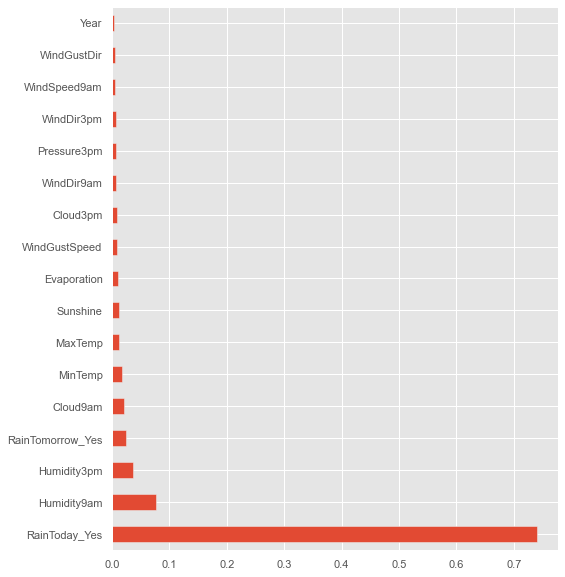

In [217]:
#Checking Feature Importance with XGBoost Model

feat_importances = pd.Series(gbr_model.feature_importances_, index=x.columns)
feat_importances.nlargest(100).plot(kind='barh',figsize=(8,10))
plt.show()

In [218]:
# load model and get predictions

model=joblib.load('Rainfall_prediction_reg.pkl')

#Predict

prediction = model.predict(x_test)

prediction

array([-0.62604642,  1.66634214, -0.50839032, ..., -0.5785657 ,
       -0.34340967, -0.53901099])

In [219]:
pd.DataFrame([model.predict(x_test)[:], y_test[:]], index = ['Predicted', 'Original'])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,...,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023,1024,1025,1026,1027,1028,1029,1030,1031,1032,1033,1034,1035,1036,1037,1038,1039,1040,1041,1042,1043,1044,1045,1046,1047,1048,1049,1050,1051,1052,1053,1054,1055,1056,1057,1058,1059,1060,1061,1062,1063,1064,1065,1066,1067,1068,1069,1070,1071,1072,1073,1074,1075,1076,1077,1078,1079,1080,1081,1082,1083,1084,1085,1086,1087,1088,1089,1090,1091,1092,1093,1094,1095,1096,1097,1098,1099,1100,1101,1102,1103,1104,1105,1106,1107,1108,1109,1110,1111,1112,1113,1114,1115,1116,1117,1118,1119,1120,1121,1122,1123,1124,1125,1126,1127,1128,1129,1130,1131,1132,1133,1134,1135,1136,1137,1138,1139,1140,1141,1142,1143,1144,1145,1146,1147,1148,1149,1150,1151,1152,1153,1154,1155,1156,1157,1158,1159,1160,1161,1162,1163,1164,1165,1166,1167,1168,1169,1170,1171,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1185,1186,1187,1188,1189,1190,1191,1192,1193,1194,1195,1196,1197,1198,1199,1200,1201,1202,1203,1204,1205,1206,1207,1208,1209,1210,1211,1212,1213,1214,1215,1216,1217,1218,1219,1220,1221,1222,1223,1224,1225,1226,1227,1228,1229,1230,1231,1232,1233,1234,1235,1236,1237,1238,1239,1240,1241,1242,1243,1244,1245,1246,1247,1248,1249,1250,1251,1252,1253,1254
Predicted,-0.626046,1.666342,-0.508390,-0.440807,-0.584031,-0.663263,-0.624266,-0.659727,-0.422437,-0.108580,-0.496168,-0.597669,-0.442879,-0.462542,-0.603868,1.615439,-0.496729,-0.629919,-0.605759,-0.587214,-0.603588,-0.546372,-0.481451,-0.633619,-0.403416,-0.555447,-0.591390,-0.493314,1.803737,-0.538190,-0.595158,-0.528229,1.749089,-0.529257,-0.496155,-0.636266,-0.629191,-0.517837,1.818693,-0.545666,-0.09214,-0.537030,-0.579138,1.76615,-0.569675,-0.643748,-0.509325,-0.529006,-0.280739,-0.420341,1.729563,1.763461,1.671165,-0.643091,-0.528213,-0.378317,1.693165,-0.481223,-0.581430,-0.562737,-0.651794,-0.652081,-0.651893,1.648937,-0.633713,-0.584213,-0.408931,-0.387818,-0.618271,-0.646576,-0.524607,-0.541518,-0.464562,-0.554452,-0.332710,1.711951,1.794974,-0.479478,-0.638573,-0.415155,-0.315608,1.697255,-0.476763,-0.594968,-0.532201,-0.661417,-0.552536,-0.607399,1.630118,1.765472,-0.501711,1.692615,-0.630257,1.353394,-0.626113,1.730557,-0.564126,-0.636318,0.204377,-0.532257,-0.554902,-0.480630,-0.623579,-0.296457,-0.599227,-0.424988,-0